<a href="https://colab.research.google.com/github/AdrianFrias/Proyecto3-Modelo-No-Supervisado/blob/main/ProyectoM3_Clusterizacion.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Librerias

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import math
from sklearn.neighbors import NearestNeighbors
from sklearn.mixture import GaussianMixture as GMM

import gc
import re
import warnings
import os
import glob
from sklearn.impute import SimpleImputer

from sklearn.ensemble import IsolationForest

import plotly.express as px
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

from yellowbrick.cluster import KElbowVisualizer
from sklearn.cluster import KMeans, SpectralClustering
from yellowbrick.cluster import SilhouetteVisualizer

from sklearn.manifold import TSNE

import umap


warnings.filterwarnings("ignore")


#Parametros

In [ ]:
plt.style.use('seaborn-v0_8-whitegrid')
sns.set_theme(style="whitegrid")
plt.rcParams['figure.figsize'] = (12, 8)
plt.rcParams['font.size']=12
pd.set_option('display.max_columns', None)
pd.set_option('display.max_colwidth', 200)

#Funciones

In [ ]:
def obtener_catalogo(subdirectorio_data,nombre):
  nombre_catalogo = f"{nombre}.csv"
  ruta_catalogo = path+subdirectorio_data+'/catalogos/'+nombre_catalogo
  catalogo = pd.read_csv(ruta_catalogo)
  catalogo.columns = catalogo.columns.str.lower()
  #display(catalogo)
  return catalogo

In [ ]:
def mapear_clave_catalogo(
  df_principal: pd.DataFrame,
  path_base: str,
  subdirectorio_data: str,
  columna_a_sustituir: str,
  columna_catalogo:str=None,
  columna_descripcion: str = 'descrip',
  longitud_clave: int = 5) -> pd.DataFrame:

  if columna_catalogo is None:
      columna_catalogo = columna_a_sustituir
  nombre_catalogo = f"{columna_a_sustituir}.csv"
  ruta_catalogo = path_base+subdirectorio_data+'/catalogos/'+nombre_catalogo
  print(ruta_catalogo)
  try:
    catalogo = pd.read_csv(ruta_catalogo)
    catalogo.columns = catalogo.columns.str.lower()

    col_clave_cat = columna_catalogo.lower()
    col_desc_cat = columna_descripcion.lower()

    df_principal[columna_a_sustituir] = df_principal[columna_a_sustituir].astype(str).str.zfill(longitud_clave)
    catalogo[col_clave_cat] = catalogo[col_clave_cat].astype(str).str.zfill(longitud_clave)

    dic_mapeo = catalogo.set_index(col_clave_cat)[col_desc_cat].to_dict()

    df_principal[f'Map_{columna_a_sustituir}'] = df_principal[columna_a_sustituir].map(dic_mapeo)
    print(f"✅ Columna '{columna_a_sustituir}' mapeada exitosamente a descripciones.")
    return df_principal

  except FileNotFoundError:
      print(f" Error: No se encontró el catálogo en la ruta: {ruta_catalogo}")
      return df_principal
  except KeyError as e:
      print(f"Eror: La columna {e} no se encontró en el catálogo o en el DataFrame principal.")
      return df_principal

#Rutas

In [ ]:
path = '/content/drive/My Drive/Datasets/ProyectoM3'
coe1='/conjunto_de_datos_coe1_enoe_2025_3t'
coe2='/conjunto_de_datos_coe2_enoe_2025_3t'
hog='/conjunto_de_datos_hog_enoe_2025_3t'
sdem='/conjunto_de_datos_sdem_enoe_2025_3t'
vivt='/conjunto_de_datos_viv_enoe_2025_3t'
cat='/catalogos/'
data='/conjunto_de_datos/'
dic='/diccionario_de_datos/'
meta='/metadatos/'
model='/modelo_entidad_relacion/'

#Dataset trabajdo

In [ ]:
df=pd.read_csv(path+'/df_maestro.csv')
df

,cve_ent,con,v_sel,n_hog,h_mud,n_ren,c_res,par_c,sex,eda,cs_p12,cs_p13_1,cs_p13_2,cs_p14_c,cs_p16,cs_p17,n_hij,e_con,cs_p20a_1,zona,clase1,clase2,clase3,pos_ocu,seg_soc,rama,c_ocu11c,ing7c,dur9c,emple7c,medica5c,buscar5c,rama_est1,rama_est2,ambito1,ambito2,tue1,tue2,tue3,busqueda,d_ant_lab,d_cexp_est,dur_des,sub_o,s_clasifi,remune2c,pre_asa,tip_con,dispo,c_inac5c,pnea_est,niv_ins,domestico,anios_esc,hrsocup,ingocup,ing_x_hrs,tpg_p8a,imssissste,scian,t_tra,emp_ppal,tue_ppal,mh_fil2,mh_col,sec_ins,tipo,nac_origen,est,est_d_tri,t_loc_tri,n_ent,p1,p2,p3,ur,mes_cal,Map_cd_a,Map_cve_ent,e_obs,p4_1,p4_2,tipolev
0,15,40170,2,1,0,1,1,Jefe_Hogar,1,64.0,1,3.0,3.0,0,0,0,0.0,5.0,1.0,0,2,4,0,0,0,0,0,0,0.0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,3,0,3,8,9,0,0.000000,0.000000,0,0,0,0,1,1,0,0,0,1,Otro_Estado,2,808,1,1,7.0,1,0,1,1,México,México,0,0,0.0,1
1,19,40270,1,1,0,1,1,Jefe_Hogar,1,58.0,1,6.0,2.0,71,1,0,0.0,5.0,1.0,0,1,1,1,2,2,4,5,4,44.0,13.0,1,4,3,7,0,3,1,1,0,2,0,0,0,0,0,0,0,0,0,0,0,3,4,11,40,10.308986,5.167175,0,4,8,1,0,0,4,4,2,1,Local,3,926,2,1,4.0,1,0,1,1,Monterrey,Nuevo León,0,0,0.0,1
2,19,40270,1,1,0,3,1,Hijos_Nietos,0,19.0,1,7.0,1.0,41,0,1,0.0,6.0,1.0,0,2,4,0,0,0,0,0,0,0.0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,4,8,13,0,0.000000,0.000000,0,0,0,0,1,1,0,0,0,1,Local,3,926,2,1,4.0,1,0,1,1,Monterrey,Nuevo León,0,0,0.0,1
3,21,40101,53,1,0,3,1,Hijos_Nietos,0,28.0,1,7.0,5.0,91,1,0,0.0,6.0,1.0,0,1,1,1,1,2,4,1,1,19.5,13.0,1,4,3,9,0,3,1,1,0,2,0,0,0,0,0,1,1,2,0,0,0,4,3,17,16,8.987322,4.764556,0,4,16,1,1,0,4,1,2,1,Local,4,976,1,5,4.0,1,0,1,3,Puebla,Puebla,0,1,1.0,1
4,21,40364,54,1,0,1,1,Jefe_Hogar,0,49.0,1,3.0,3.0,0,0,0,2.0,4.0,1.0,0,1,1,1,1,2,4,8,1,37.0,1.0,4,4,3,10,0,1,3,6,0,2,0,0,0,0,0,1,2,1,0,0,0,3,3,9,38,8.366603,3.307465,0,4,19,1,1,0,2,1,9,1,Otro_Estado,1,973,1,3,3.0,1,0,1,3,Puebla,Puebla,0,0,0.0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
411551,17,60014,66,1,0,3,1,Hijos_Nietos,0,31.0,1,3.0,3.0,0,0,0,0.0,6.0,1.0,0,2,4,0,0,0,0,0,0,0.0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,3,8,9,0,0.000000,0.000000,0,0,0,0,1,1,0,0,0,1,Local,2,898,4,4,4.0,1,0,0,1,Complemento urbano-Rural,Morelos,0,0,0.0,1
411552,20,60009,20,1,0,1,1,Jefe_Hogar,1,61.0,1,2.0,3.0,0,0,0,0.0,5.0,1.0,0,1,1,1,3,2,1,5,1,7.5,1.0,1,4,2,4,0,1,3,5,0,2,0,0,0,1,2,0,0,0,0,0,0,1,4,3,10,8.366603,4.615121,0,4,4,2,1,1,1,1,8,2,Local,1,970,4,1,2.0,1,0,0,3,Complemento urbano-Rural,Oaxaca,0,0,0.0,1
411553,27,60016,59,1,0,1,1,Jefe_Hogar,1,77.0,1,2.0,2.0,0,0,0,0.0,5.0,1.0,0,2,4,0,0,0,0,0,0,0.0,0.0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2,0,1,8,2,0,0.000000,0.000000,0,0,0,0,1,1,0,0,0,1,Otro_Estado,2,1116,4,3,2.0,1,0,0,2,Complemento urbano-Rural,Tabasco,0,0,0.0,1
411554,29,60049,88,1,0,7,1,Familia_Extensa,0,56.0,1,2.0,6.0,0,0,0,1.0,6.0,1.0,0,1,1,1,1,2,4,8,2,44.0,3.5,4,4,3,10,0,1,3,6,0,2,0,0,0,0,0,1,2,1,0,0,0,2,1,6,48,9.059634,3.753418,0,4,19,1,1,0,2,1,9,2,Local,1,1160,4,3,7.0,1,0,0,3,Complemento urbano-Rural,Tlaxcala,0,0,0.0,0


#Agrupacion de columnas

In [ ]:
indices=['cve_ent', 'con', 'v_sel', 'tipo','n_hog','h_mud','n_ren']

In [ ]:
vivt_categoricas= [
    "est",
    "est_d_tri",
    "Map_cd_a",
    "Map_cve_ent"
]
vivt_numericas= [
    "p1",
    "p2",
    "p3",
    "ur"
]
vivt_ordinales= [
    "t_loc_tri",
    "n_ent",
    "mes_cal"
]

In [ ]:
hogt_numericas= [
    "e_obs",
    "p4_2",
    "tipolev"
]
hogt_ordinales=["p4_1"]

In [ ]:
sdmet_categoricas = [
    "par_c",
    "nac_origen",
    "cs_p14_c",
    "e_con",
    "cs_p20a_1",
    "clase1",
    "clase2",
    "clase3",
    "pos_ocu",
    "seg_soc",
    "rama",
    "c_ocu11c",
    "medica5c",
    "buscar5c",
    "s_clasifi",
    "tue1",
    "tue2",
    "tue3",
    "busqueda",
    #"d_cexp_est",
    "c_inac5c",
    "domestico",
    "imssissste",
    "scian",
    "sec_ins"
]

sdmet_numericas = [
    "sex",
    "eda",
    "cs_p12",
    "cs_p13_2",
    "cs_p16",
    "cs_p17",
    "n_hij",
    "zona",
    "ambito1",
    "sub_o",
    "remune2c",
    "dispo",
    "pnea_est",
    #"d_ant_lab",
    "hrsocup",
    "ingocup",
    "ing_x_hrs",
    "tpg_p8a",
    "t_tra",
    "emp_ppal",
    "tue_ppal",
    "c_res"
]
sdmet_ordinales = [
    "cs_p13_1",
    "ing7c",
    "dur9c",
    "emple7c",
    "rama_est1",
    "rama_est2",
    "ambito2",
    "dur_des",
    "pre_asa",
    "tip_con",
    "niv_ins",
    "anios_esc",
    "mh_fil2",
    "mh_col"
]

In [ ]:
print(len(sdmet_categoricas))
print(len(sdmet_numericas))
print(len(sdmet_ordinales))

print(len(vivt_categoricas))
print(len(vivt_numericas))
print(len(vivt_ordinales))

print(len(hogt_numericas))
print(len(hogt_ordinales))


24
21
14
4
4
3
3
1


In [ ]:
df.columns.difference(sdmet_categoricas+sdmet_numericas+sdmet_ordinales+vivt_categoricas+vivt_numericas+vivt_ordinales+hogt_numericas+hogt_ordinales)

Index(['con', 'cve_ent', 'd_ant_lab', 'd_cexp_est', 'h_mud', 'n_hog', 'n_ren',
       'tipo', 'v_sel'],
      dtype='object')

#Categorias a frecuencias

In [ ]:
columnas_categoricas = sdmet_categoricas + vivt_categoricas

cols_frecuencia = []

for col in columnas_categoricas:
    nueva_col = f'{col}_frec'

    frecuencias = df[col].value_counts(normalize=True).to_dict()

    df[nueva_col] = df[col].map(frecuencias)

    cols_frecuencia.append(nueva_col)

#cols_frecuencia

#Separacion de numericas y dummies

In [ ]:
columnas_numericas = sdmet_numericas + vivt_numericas + hogt_numericas

cols_binarias = []
cols_continuas = []

for col in columnas_numericas:
    if col in df.columns:
        n_valores_unicos = df[col].nunique()

        if n_valores_unicos == 2:
            cols_binarias.append(col)
        elif n_valores_unicos > 2:
            cols_continuas.append(col)

In [ ]:
print(len(cols_frecuencia))
print(len(columnas_numericas))
print(len(cols_binarias))
print(len(sdmet_ordinales))
print(len(hogt_ordinales))
print(len(vivt_ordinales))

28
28
19
14
1
3


In [ ]:
df_completo = df[cols_frecuencia+cols_continuas+cols_binarias+sdmet_ordinales+hogt_ordinales+vivt_ordinales]
df_numerico=df[cols_frecuencia+cols_continuas+sdmet_ordinales+hogt_ordinales+vivt_ordinales]
df_numerico

,par_c_frec,nac_origen_frec,cs_p14_c_frec,e_con_frec,cs_p20a_1_frec,clase1_frec,clase2_frec,clase3_frec,pos_ocu_frec,seg_soc_frec,rama_frec,c_ocu11c_frec,medica5c_frec,buscar5c_frec,s_clasifi_frec,tue1_frec,tue2_frec,tue3_frec,busqueda_frec,c_inac5c_frec,domestico_frec,imssissste_frec,scian_frec,sec_ins_frec,est_frec,est_d_tri_frec,Map_cd_a_frec,Map_cve_ent_frec,eda,cs_p13_2,n_hij,hrsocup,ingocup,ing_x_hrs,t_tra,p1,p4_2,cs_p13_1,ing7c,dur9c,emple7c,rama_est1,rama_est2,ambito2,dur_des,pre_asa,tip_con,niv_ins,anios_esc,mh_fil2,mh_col,p4_1,t_loc_tri,n_ent,mes_cal
0,0.304219,0.171702,0.786457,0.284404,0.994705,0.361052,0.320904,0.519076,0.532994,0.532994,0.532994,0.532994,0.532994,0.532994,0.966408,0.532994,0.536073,0.946931,0.532994,0.042932,0.264460,0.532994,0.532994,0.532994,0.449161,0.006388,0.038464,0.042726,64.0,3.0,0.0,0,0.000000,0.000000,0,7.0,0.0,3.0,0,0.0,0.0,0,0,0,0,0,0,3,9,0,0,0,1,1,1
1,0.304219,0.819689,0.024828,0.284404,0.994705,0.480924,0.467006,0.444608,0.028664,0.266294,0.215701,0.122797,0.223547,0.451620,0.966408,0.246610,0.136081,0.946931,0.464267,0.638948,0.045053,0.266294,0.023127,0.132201,0.266588,0.000530,0.022580,0.031310,58.0,2.0,0.0,40,10.308986,5.167175,1,4.0,0.0,6.0,4,44.0,13.0,3,7,3,0,0,0,3,11,4,4,0,2,1,1
2,0.445913,0.819689,0.026300,0.471613,0.994705,0.361052,0.320904,0.519076,0.532994,0.532994,0.532994,0.532994,0.532994,0.532994,0.966408,0.532994,0.536073,0.946931,0.532994,0.118149,0.264460,0.532994,0.532994,0.532994,0.266588,0.000530,0.022580,0.031310,19.0,1.0,0.0,0,0.000000,0.000000,0,4.0,0.0,7.0,0,0.0,0.0,0,0,0,0,0,0,4,13,0,0,0,2,1,1
3,0.445913,0.819689,0.005773,0.471613,0.994705,0.480924,0.467006,0.444608,0.329430,0.266294,0.215701,0.055715,0.223547,0.451620,0.966408,0.246610,0.136081,0.946931,0.464267,0.638948,0.362524,0.266294,0.017521,0.132201,0.125295,0.002984,0.021540,0.035728,28.0,5.0,0.0,16,8.987322,4.764556,1,4.0,1.0,7.0,1,19.5,13.0,3,9,3,0,1,2,4,17,4,1,1,1,5,3
4,0.304219,0.171702,0.786457,0.045709,0.994705,0.480924,0.467006,0.444608,0.329430,0.266294,0.215701,0.071888,0.042434,0.451620,0.966408,0.155758,0.018068,0.946931,0.464267,0.638948,0.362524,0.266294,0.044516,0.018068,0.158955,0.000578,0.021540,0.035728,49.0,3.0,2.0,38,8.366603,3.307465,1,3.0,0.0,3.0,1,37.0,1.0,3,10,1,0,2,1,3,9,2,1,0,1,3,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
411551,0.445913,0.819689,0.786457,0.471613,0.994705,0.361052,0.320904,0.519076,0.532994,0.532994,0.532994,0.532994,0.532994,0.532994,0.966408,0.532994,0.536073,0.946931,0.532994,0.162775,0.264460,0.532994,0.532994,0.532994,0.449161,0.002279,0.366538,0.026116,31.0,3.0,0.0,0,0.000000,0.000000,0,4.0,0.0,3.0,0,0.0,0.0,0,0,0,0,0,0,3,9,0,0,0,4,4,1
411552,0.304219,0.819689,0.786457,0.284404,0.994705,0.480924,0.467006,0.444608,0.092333,0.266294,0.037735,0.122797,0.223547,0.451620,0.020403,0.155758,0.128828,0.946931,0.464267,0.638948,0.045053,0.266294,0.037735,0.128828,0.158955,0.007826,0.366538,0.033531,61.0,3.0,0.0,10,8.366603,4.615121,2,2.0,0.0,2.0,1,7.5,1.0,2,4,1,0,0,0,1,3,1,1,0,4,1,3
411553,0.304219,0.171702,0.786457,0.284404,0.994705,0.361052,0.320904,0.519076,0.532994,0.532994,0.532994,0.532994,0.532994,0.532994,0.966408,0.532994,0.536073,0.946931,0.532994,0.162775,0.264460,0.532994,0.532994,0.532994,0.449161,0.003611,0.366538,0.027848,77.0,2.0,0.0,0,0.000000,0.000000,0,2.0,0.0,2.0,0,0.0,0.0,0,0,0,0,0,0,1,2,0,0,0,4,3,2
411554,0.062927,0.819689,0.786457,0.471613,0.994705,0.480924,0.467006,0.444608,0.329430,0.266294,0.215701,0.071888,0.042434,0.451620,0.966408,0.155758,0.018068,0.946931,0.464267,0.638948,0.051694,0.266294,0.044516,0.018068,0.158955,0.001497,0.366538,0.029308,56.0,6.0,1.0,48,9.059634,3.753418,1,7.0,0.0,2.0,2,44.0,3.5,3,10,1,0,2,1,2,6,2,1,0,4,3,3


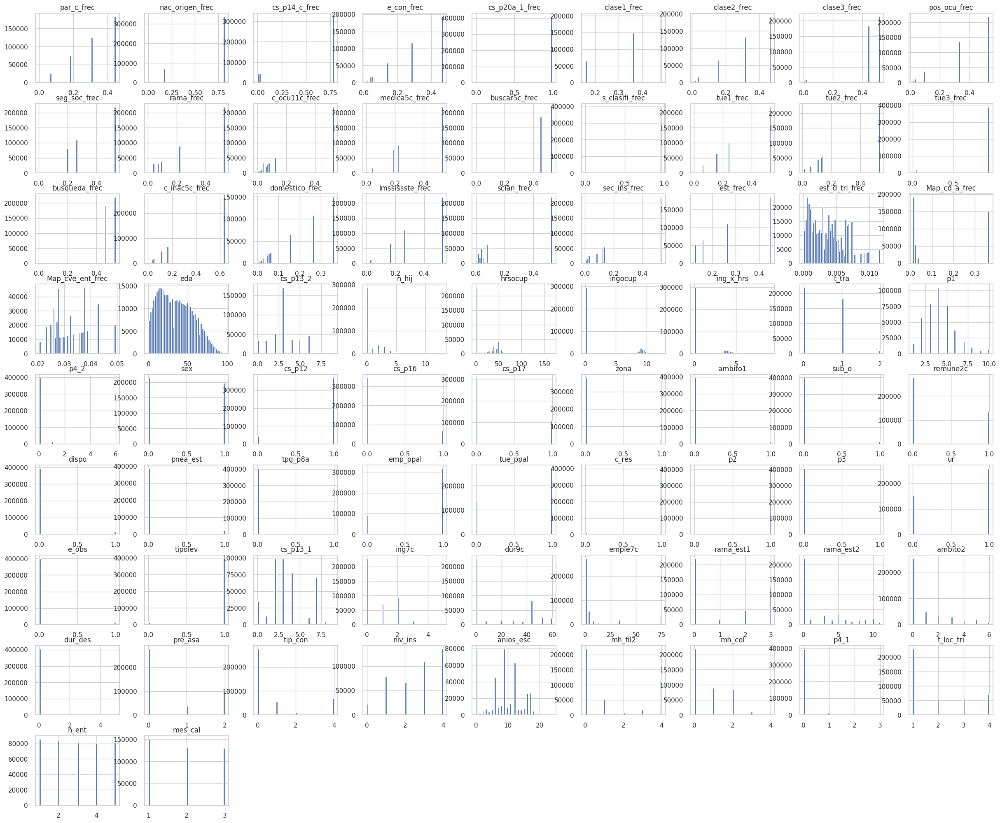

In [ ]:
df_completo.hist(bins=50, figsize=(30, 25));

#Outliers

In [ ]:
iso = IsolationForest(contamination='auto', random_state=13, n_jobs=-1)

In [ ]:
outliers_pred = iso.fit_predict(df_numerico)

In [ ]:
df['es_outlier'] = outliers_pred

Los outliers son bastante grandes que posiblemente se un cubjonto de nuestos datos y dado que en una poblacion se tiene mucho desbalanceo de datos se esta detectando cierto subjonto de datos

In [ ]:
print(df['es_outlier'].value_counts())
print(df['es_outlier'].value_counts()*100/len(df))


es_outlier
 1    273397
-1    138159
Name: count, dtype: int64
es_outlier
 1    66.430085
-1    33.569915
Name: count, dtype: float64


In [ ]:
df_outliers = df[df['es_outlier'] == -1]
df_limpio=df[df['es_outlier'] != -1]

In [ ]:
df_completo = df_limpio[cols_frecuencia+cols_continuas+cols_binarias+sdmet_ordinales+hogt_ordinales+vivt_ordinales]
df_numerico=df_limpio[cols_frecuencia+cols_continuas+sdmet_ordinales+hogt_ordinales+vivt_ordinales]

In [ ]:
df_completo_out=df_outliers[cols_frecuencia+cols_continuas+cols_binarias+sdmet_ordinales+hogt_ordinales+vivt_ordinales]
df_numerico_out=df_outliers[cols_frecuencia+cols_continuas+sdmet_ordinales+hogt_ordinales+vivt_ordinales]

In [ ]:
df_completo.reset_index(drop=True, inplace=True)
df_numerico.reset_index(drop=True, inplace=True)
df_limpio.reset_index(drop=True, inplace=True)

df_completo_out.reset_index(drop=True, inplace=True)
df_numerico_out.reset_index(drop=True, inplace=True)
df_outliers.reset_index(drop=True, inplace=True)

In [ ]:
for var in df_completo.columns:
  if df_completo[var].nunique() ==1:
    print(df_completo[var].value_counts())
    if var in cols_frecuencia:
        cols_frecuencia.remove(var)
    if var in cols_continuas:
        cols_continuas.remove(var)
    if var in sdmet_ordinales:
        sdmet_ordinales.remove(var)
    if var in hogt_ordinales:
        hogt_ordinales.remove(var)
    if var in vivt_ordinales:
        vivt_ordinales.remove(var)
    if var in cols_binarias:
        cols_binarias.remove(var)

In [ ]:
for var in df_completo_out.columns:
  if df_completo_out[var].nunique() ==1:
    print(var)
    print(df_completo_out[var].value_counts())
    if var in cols_frecuencia:
        cols_frecuencia.remove(var)
    if var in cols_continuas:
        cols_continuas.remove(var)
    if var in sdmet_ordinales:
        sdmet_ordinales.remove(var)
    if var in hogt_ordinales:
        hogt_ordinales.remove(var)
    if var in vivt_ordinales:
        vivt_ordinales.remove(var)
    if var in cols_binarias:
        cols_binarias.remove(var)

#Multicolonolidad

##Variables binarias

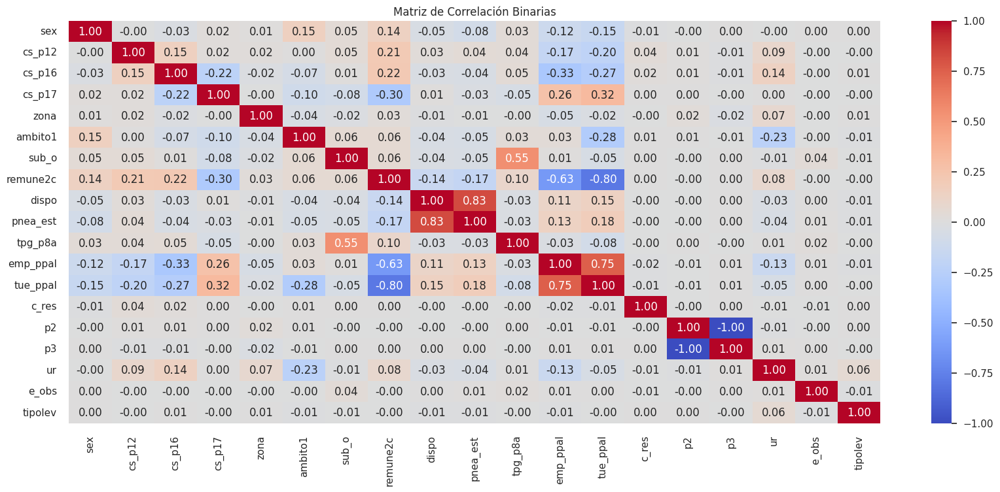

In [ ]:
plt.figure(figsize=(20, 8))
sns.heatmap(df[cols_binarias].corr(), annot=True, cmap='coolwarm',fmt='.2f')
plt.title('Matriz de Correlación Binarias')
plt.show()

Son mutuamente excluyentes ya que describen la formalidad del empleador pero sus etiquetas estan a al inversa

In [ ]:
display(obtener_catalogo(sdem, 'tue_ppal'))
display(obtener_catalogo(sdem, 'remune2c'))

,cve,descrip
0,0,No aplica
1,1,Sector informal
2,2,Fuera del sector informal


,cve,descrip
0,0,No aplica
1,1,Subordinados y remunerados-asalariados
2,2,Subordinados y remunerados-con percepciones no salariales


In [ ]:
cols_binarias.remove('remune2c')

P2 y P3 son mutuamente excluyentes

In [ ]:
cols_binarias.remove('p3')

pnea_est describe mejor esta variable

In [ ]:
display(obtener_catalogo(sdem, 'dispo'))
display(obtener_catalogo(sdem, 'pnea_est'))

,cve,descrip
0,0,No aplica
1,1,Primera opción
2,2,Segunda opción
3,3,Tercera opción
4,4,Cuarta opción
5,5,Quinta opción
6,6,Sexta opción
7,7,Séptima opción


,cve,descrip
0,0,No aplica
1,1,Disponible para trabajar que han desistido de buscar empleo
2,2,Disponibles para trabajar que no buscan empleo por considerar que no tienen posibilidades
3,3,Con interés para trabajar pero bajo un contexto que les impide hacerlo
4,4,Sin interés por trabajar por atender otras obligaciones
5,5,Con impedimentos físicos para trabajar
6,6,Otros


In [ ]:
cols_binarias.remove('dispo')

##Variables binarias y continuas

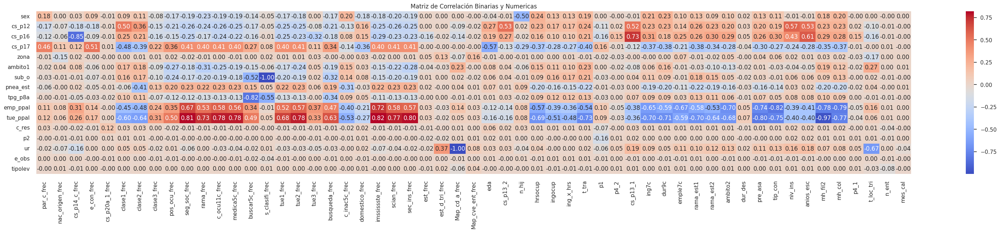

In [ ]:
cols_y = cols_binarias
cols_x = cols_frecuencia + cols_continuas + sdmet_ordinales + hogt_ordinales + vivt_ordinales

columnas_totales = cols_y + cols_x
matriz_correlacion_completa = df[columnas_totales].corr()

matriz_correlacion_sub = matriz_correlacion_completa.loc[cols_y, cols_x]

plt.figure(figsize=(40, 6))
sns.heatmap(matriz_correlacion_sub, annot=True, cmap='coolwarm', fmt='.2f')
plt.title('Matriz de Correlación Binarias y Numericas')
plt.show()

Se quedara con la binaria

In [ ]:
display(obtener_catalogo(sdem, 'tpg_p8a'))
display(obtener_catalogo(sdem, 'buscar5c'))

,cve,descrip
0,0,No aplica
1,1,Si busco trabajo (Para calculo de las tasas)


,cve,descrip
0,0,No aplica
1,1,Para tener otro empleo
2,2,Para cambiarse de trabajo
3,3,Otro
4,4,No buscó
5,5,No especificado


In [ ]:
cols_frecuencia.remove('buscar5c_frec')

tue_ppal es la variable que describe la formalidad y el resto son variables que tienen relacino con este tipo de dato.

Lo que se hara sera revisar cuales eliminar y cuales deberan quedarse

- tue_ppal se queda por se la general
- mh_col que combina la posicion y la formalidad
- tip_con que define estabilidad
- scian que es el sector se queda
- c_ocu11c que distingue posiciones
- t_tra que es el numero de trabajos

A eliminar serian

- seg_soc ya que el acceso se define por la formalidad del empleo
- imssissste que es solo una subcategoría de seg_soc.
- pre_asa redundancia ya que tTener prestaciones es la definición de Empleo Formal
- mh_fil2 sus códigos son casi idénticos a los grupos en tue_ppal y scian.
- sec_ins redundancia ya que mezcla el sector de scian con la formalidad.
- rama redundancia con scian
- medica5c relacion con las nateriores de salus y prestacionas

In [ ]:
display(obtener_catalogo(sdem, 'tue_ppal'))
display(obtener_catalogo(sdem, 'seg_soc'))
display(obtener_catalogo(sdem, 'rama'))
display(obtener_catalogo(sdem, 'c_ocu11c'))
display(obtener_catalogo(sdem, 'medica5c'))
display(obtener_catalogo(sdem, 'imssissste'))
display(obtener_catalogo(sdem, 'scian'))
display(obtener_catalogo(sdem, 't_tra'))
display(obtener_catalogo(sdem, 'sec_ins'))
display(obtener_catalogo(sdem, 'pre_asa'))
display(obtener_catalogo(sdem, 'tip_con'))
display(obtener_catalogo(sdem, 'mh_fil2'))
display(obtener_catalogo(sdem, 'mh_col'))



,cve,descrip
0,0,No aplica
1,1,Sector informal
2,2,Fuera del sector informal


,cve,descrip
0,0,No aplica
1,1,Con acceso
2,2,Sin acceso
3,3,No especificado


,cve,descrip
0,0,No aplica
1,6,Agropecuario
2,1,Construcción
3,2,Industria manufacturera
4,3,Comercio
5,4,Servicios
6,5,Otros
7,7,No especificado


,cve,descrip
0,0,No aplica
1,1,"Profesionales, técnicos y trabajadores del arte"
2,2,Trabajadores de la educación
3,3,Funcionarios y directivos
4,4,Oficinistas
5,5,Trabajadores industriales artesanos y ayudantes
6,6,Comerciantes
7,7,Operadores de transporte
8,8,Trabajadores en servicios personales
9,9,Trabajadores en protección y vigilancia


,cve,descrip
0,0,No aplica
1,1,Sin prestaciones
2,2,Solo acceso a instituciones de salud
3,3,Acceso de instituciones de salud y otras prestaciones
4,4,No tiene acceso a instituciones de salud pero si a otras prestaciones
5,5,No especificado


,cve,descrip
0,0,No aplica
1,1,Imss
2,2,Issste
3,3,Otras instituciones
4,4,No recibe atención médica
5,5,No especificado


,cve,descrip
0,0,No aplica
1,1,"Agricultura, ganadería, aprovechamiento forestal, pesca y caza"
2,2,Minería
3,3,"Generación y distribución de electricidad, suministro de agua y gas"
4,4,Construcción
5,5,Industrias manufactureras
6,6,Comercio al por mayor
7,7,Comercio al por menor
8,8,"Transportes, correos y almacenamiento"
9,9,Información en medios masivos


,cve,descrip
0,0,No aplica
1,1,Un solo trabajo
2,2,Dos trabajos


,cve,descrip
0,0,No aplica
1,1,Instituciones financieras
2,2,Corporaciones y sociedades no financieras
3,3,Agropecuario
4,4,No agropecuario
5,5,Gobierno
6,6,Privadas
7,7,Públicas
8,8,Sector Informal
9,9,Trabajo doméstico remunerado


,cve,descrip
0,0,No aplica
1,1,Con prestaciones
2,2,Sin prestaciones
3,3,No especificado


,cve,descrip
0,0,No aplica
1,1,Con contrato escrito
2,2,Temporal
3,3,"De base, planta o por tiempo indefinido"
4,4,Contrato de tipo no especificado
5,5,Sin contrato escrito
6,6,No especificado


,cve,descrip
0,0,No aplica
1,1,Sector informal
2,2,Trabajo doméstico remunerado
3,3,"Empresas, Gobierno e Instituciones"
4,4,Ámbito agropecuario


,cve,descrip
0,0,No aplica
1,1,Trabajadores subordinados y remunerados - Asalariados INFORMALES
2,2,Trabajadores subordinados y remunerados - Asalariados FORMALES
3,3,Trabajadores subordinados y remunerados - Con percepciones no salariales INFORMALES
4,4,Trabajadores subordinados y remunerados - Con percepciones no salariales FORMALES
5,5,Empleadores INFORMAL
6,6,Empleadores FORMAL
7,7,Trabajadores por cuenta propia INFORMAL
8,8,Trabajadores por cuenta propia FORMAL
9,9,Trabajadores no Remunerados INFORMAL


In [ ]:
variables_redundantes = [
    'seg_soc',
    'imssissste',
    'pre_asa',
    'mh_fil2',
    'sec_ins',
    'rama',
    'medica5c'
]
for var in variables_redundantes:
    frec_var = f'{var}_frec'
    if frec_var in cols_frecuencia:
        cols_frecuencia.remove(frec_var)
    if var in cols_continuas:
        cols_continuas.remove(var)
    if var in sdmet_ordinales:
        sdmet_ordinales.remove(var)
    if var in hogt_ordinales:
        hogt_ordinales.remove(var)
    if var in vivt_ordinales:
        vivt_ordinales.remove(var)

ambas describen zonas urbanas y rurales, se quedara con la binaria

In [ ]:
display(obtener_catalogo(sdem, 'ur'))
display(obtener_catalogo(sdem, 'cd_a'))

,cve,descrip
0,1,Muestra urbana
1,2,Muestra complemento y rural


,cve,descrip
0,1,México
1,2,Guadalajara
2,3,Monterrey
3,4,Puebla
4,5,León
5,6,Torreón
6,7,San Luis Potosí
7,8,Mérida
8,9,Chihuahua
9,10,Tampico


In [ ]:
cols_frecuencia.remove('Map_cd_a_frec')

Se quedara con la binaria

In [ ]:
display(obtener_catalogo(sdem, 'sub_o'))
display(obtener_catalogo(sdem, 's_clasifi'))

,cve,descrip
0,1,Si es subocupado


,cve,descrip
0,0,No aplica
1,1,Pers. c/ nexo labo. p/ afec. p/ paro técnico
2,2,Pers. afecta. p/ una caida en el ritmo de su activi.
3,3,Pers. q/laboran - de 35 h p/ razones de mercado
4,4,Pers. q/laboran + de 35 h p/ - de lo habitual p/razones de mer.
5,5,Pers. q/ buscan aumen. su jor. lab. p/ obtener + ing.
6,6,Ausentes con retorno en la semana de la entrevista


In [ ]:
cols_frecuencia.remove('s_clasifi_frec')

cs_p16 dice si termino la carrera teneiendo un valor de 0 si no la acabaron y cs_p14_c dice la carrera que se estudio y como los que no la terminaron son mas frecuentes tendran un valor alto, es por eso que se invirtio la correlacion, se quedara con la binaria

In [ ]:
display(obtener_catalogo(sdem, 'cs_p16'))
display(obtener_catalogo(sdem, 'cs_p14_c'))

,cve,descrip
0,1,Sí
1,2,No
2,9,No sabe


,cve,descrip
0,11000,Planes multidisciplinarios o generales del campo de ciencias de la educación y pedagogía
1,11100,Diseño curricular y pedagogía
2,11200,"Planeación, evaluación e investigación educativa"
3,11300,Orientación e intervención educativa
4,11400,Tecnología y comunicación educativa
...,...,...
181,102100,Servicios de transporte
182,103100,Seguridad para el trabajo
183,104100,Seguridad pública
184,104200,Servicios militares


In [ ]:
cols_frecuencia.remove('cs_p14_c_frec')

In [ ]:
df_completo = df_limpio[cols_frecuencia+cols_continuas+cols_binarias+sdmet_ordinales+hogt_ordinales+vivt_ordinales]
df_numerico=df_limpio[cols_frecuencia+cols_continuas+sdmet_ordinales+hogt_ordinales+vivt_ordinales]

In [ ]:
df_completo_out = df_outliers[cols_frecuencia+cols_continuas+cols_binarias+sdmet_ordinales+hogt_ordinales+vivt_ordinales]
df_numerico_out=df_outliers[cols_frecuencia+cols_continuas+sdmet_ordinales+hogt_ordinales+vivt_ordinales]

In [ ]:
df_numerico

,par_c_frec,nac_origen_frec,e_con_frec,cs_p20a_1_frec,clase1_frec,clase2_frec,clase3_frec,pos_ocu_frec,c_ocu11c_frec,tue1_frec,tue2_frec,tue3_frec,busqueda_frec,c_inac5c_frec,domestico_frec,scian_frec,est_frec,est_d_tri_frec,Map_cve_ent_frec,eda,cs_p13_2,n_hij,hrsocup,ingocup,ing_x_hrs,t_tra,p1,p4_2,cs_p13_1,ing7c,dur9c,emple7c,rama_est1,rama_est2,ambito2,dur_des,tip_con,niv_ins,anios_esc,mh_col,p4_1,t_loc_tri,n_ent,mes_cal
0,0.304219,0.171702,0.284404,0.994705,0.361052,0.320904,0.519076,0.532994,0.532994,0.532994,0.536073,0.946931,0.532994,0.042932,0.264460,0.532994,0.449161,0.006388,0.042726,64.0,3.0,0.0,0,0.000000,0.000000,0,7.0,0.0,3.0,0,0.0,0.0,0,0,0,0,0,3,9,0,0,1,1,1
1,0.445913,0.819689,0.471613,0.994705,0.361052,0.320904,0.519076,0.532994,0.532994,0.532994,0.536073,0.946931,0.532994,0.118149,0.264460,0.532994,0.266588,0.000530,0.031310,19.0,1.0,0.0,0,0.000000,0.000000,0,4.0,0.0,7.0,0,0.0,0.0,0,0,0,0,0,4,13,0,0,2,1,1
2,0.445913,0.819689,0.471613,0.994705,0.361052,0.320904,0.519076,0.532994,0.532994,0.532994,0.536073,0.946931,0.532994,0.118149,0.059042,0.532994,0.125295,0.002709,0.037900,14.0,1.0,0.0,0,0.000000,0.000000,0,4.0,0.0,3.0,0,0.0,0.0,0,0,0,0,0,2,7,0,0,1,4,1
3,0.181817,0.819689,0.139855,0.994705,0.361052,0.320904,0.519076,0.532994,0.532994,0.532994,0.536073,0.946931,0.532994,0.162775,0.264460,0.532994,0.449161,0.003569,0.036289,44.0,6.0,2.0,0,0.000000,0.000000,0,4.0,0.0,2.0,0,0.0,0.0,0,0,0,0,0,2,6,0,0,1,1,2
4,0.445913,0.819689,0.471613,0.994705,0.361052,0.320904,0.519076,0.532994,0.532994,0.532994,0.536073,0.946931,0.532994,0.118149,0.264460,0.532994,0.449161,0.003569,0.036289,12.0,1.0,0.0,0,0.000000,0.000000,0,4.0,0.0,3.0,0,0.0,0.0,0,0,0,0,0,2,7,0,0,1,1,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
273392,0.181817,0.819689,0.284404,0.994705,0.361052,0.320904,0.519076,0.532994,0.532994,0.532994,0.536073,0.946931,0.532994,0.162775,0.264460,0.532994,0.449161,0.002437,0.032584,64.0,6.0,3.0,0,0.000000,0.000000,0,2.0,0.0,2.0,0,0.0,0.0,0,0,0,0,0,2,6,0,0,4,3,2
273393,0.445913,0.171702,0.471613,0.994705,0.480924,0.467006,0.444608,0.092333,0.081471,0.155758,0.128828,0.946931,0.464267,0.638948,0.362524,0.042563,0.266588,0.000498,0.042726,39.0,3.0,0.0,30,9.241936,4.394449,1,4.0,0.0,3.0,2,29.5,3.5,3,6,1,0,0,3,9,1,0,4,2,3
273394,0.445913,0.819689,0.471613,0.994705,0.361052,0.320904,0.519076,0.532994,0.532994,0.532994,0.536073,0.946931,0.532994,0.162775,0.264460,0.532994,0.449161,0.002279,0.026116,31.0,3.0,0.0,0,0.000000,0.000000,0,4.0,0.0,3.0,0,0.0,0.0,0,0,0,0,0,3,9,0,0,4,4,1
273395,0.304219,0.171702,0.284404,0.994705,0.361052,0.320904,0.519076,0.532994,0.532994,0.532994,0.536073,0.946931,0.532994,0.162775,0.264460,0.532994,0.449161,0.003611,0.027848,77.0,2.0,0.0,0,0.000000,0.000000,0,2.0,0.0,2.0,0,0.0,0.0,0,0,0,0,0,1,2,0,0,4,3,2


##Variables continuas

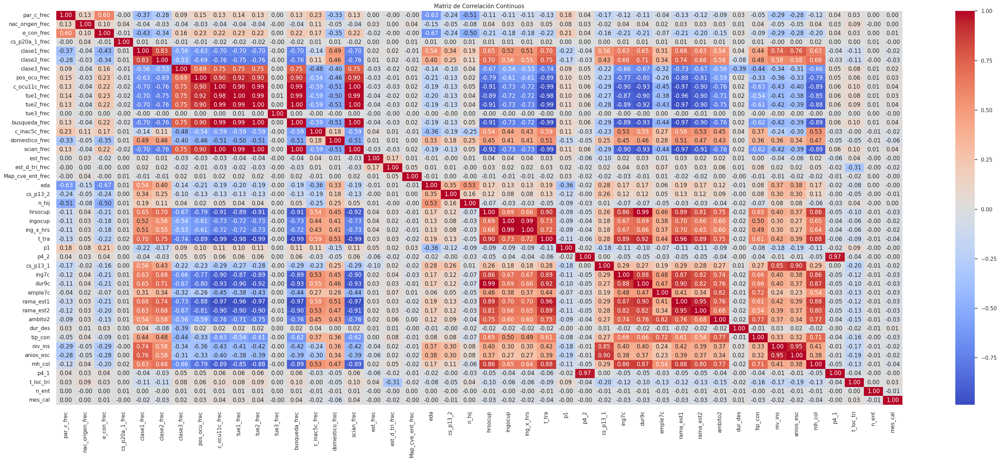

In [ ]:
plt.figure(figsize=(40, 15))
sns.heatmap(df_numerico.corr(), annot=True, cmap='coolwarm',fmt='.2f')
plt.title('Matriz de Correlación Continuos')
plt.show()

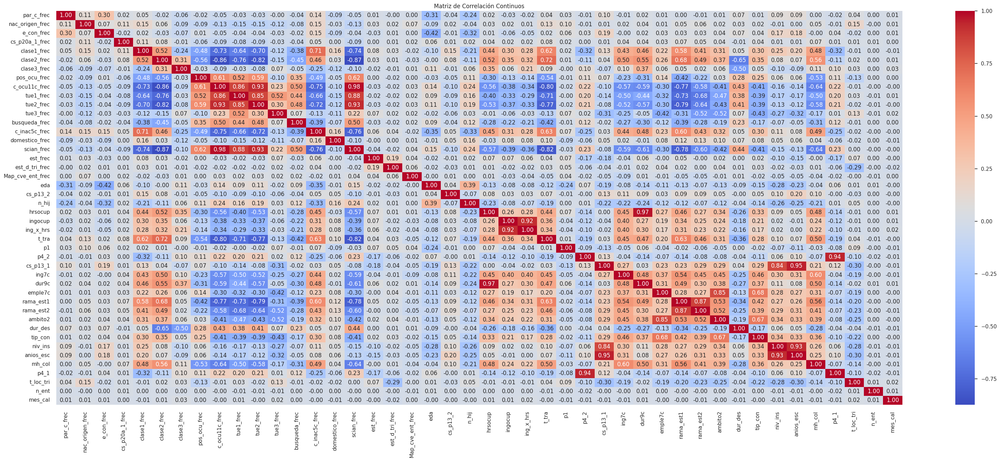

In [ ]:
plt.figure(figsize=(40, 15))
sns.heatmap(df_numerico_out.corr(), annot=True, cmap='coolwarm',fmt='.2f')
plt.title('Matriz de Correlación Continuos')
plt.show()

Se usara PCA como metodo para reducir las dimensiones

###Sin outliers

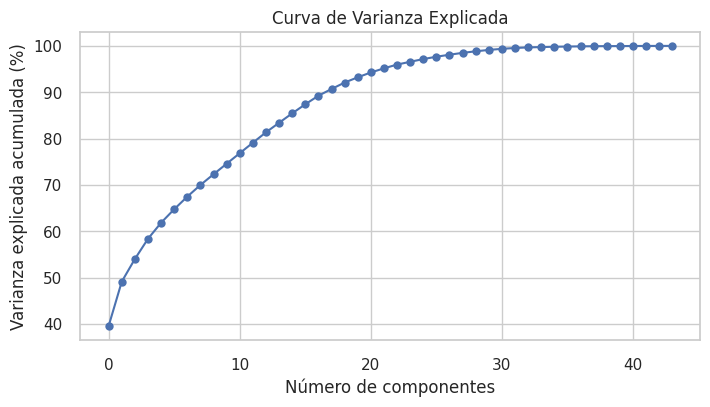

In [ ]:
scaler = StandardScaler()
df_num = scaler.fit_transform(df_numerico)

pca_full = PCA(n_components=df_num.shape[1])
pca_full.fit(df_num)

plt.figure(figsize=(8, 4))
plt.plot(np.cumsum(pca_full.explained_variance_ratio_) * 100, marker='o')
plt.grid(True)
plt.xlabel('Número de componentes')
plt.ylabel('Varianza explicada acumulada (%)')
plt.title('Curva de Varianza Explicada')
plt.show()

In [ ]:
i=1
for elemento in np.cumsum(pca_full.explained_variance_ratio_) * 100:
  if i>15 and i<30:
    print(f"{i}: {round(elemento,2)}")
  i+=1

16: 87.4
17: 89.24
18: 90.7
19: 92.08
20: 93.22
21: 94.26
22: 95.16
23: 95.97
24: 96.57
25: 97.15
26: 97.66
27: 98.09
28: 98.5
29: 98.83


In [ ]:
n=22
pca_n = PCA(n_components=n)
componentes_n = pca_n.fit_transform(df_num)
cols_n = [f'PC{i+1}' for i in range(n)]
data_pca_n = pd.DataFrame(componentes_n, columns=cols_n)

In [ ]:
df_completo_PCA=pd.concat([data_pca_n,df_limpio[cols_binarias]],axis=1)
df_completo_PCA

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15,PC16,PC17,PC18,PC19,PC20,PC21,PC22,sex,cs_p12,cs_p16,cs_p17,zona,ambito1,sub_o,pnea_est,tpg_p8a,emp_ppal,tue_ppal,c_res,p2,ur,e_obs,tipolev
0,1.923567,2.014604,-0.037094,-0.515222,1.007953,1.599372,-1.018882,-0.162629,-0.374995,1.003695,1.526285,0.078211,-0.558675,-0.956313,-2.716636,-0.204699,-0.216012,-0.459371,0.136499,0.014041,-1.182368,0.256070,1,1,0,0,0,0,0,0,0,1,1,1,1,1,0,1
1,1.794102,1.269481,2.347033,-1.419837,-1.291513,-1.014415,0.184916,-0.003181,-0.026987,0.700736,1.237172,0.091042,-1.316214,-0.325206,0.268368,0.829256,-1.246113,0.638079,-0.448668,0.329021,-0.087252,0.138905,0,1,0,1,0,0,0,0,0,1,1,1,1,1,0,1
2,2.586035,-0.387545,1.356717,-0.768232,-0.367707,-0.353413,-0.222850,-0.609850,1.634714,-0.069361,0.850403,0.180231,0.611664,0.071236,0.430198,0.666158,-0.411545,-1.445825,-0.007194,0.907498,-0.094247,-0.244938,1,1,0,1,0,0,0,0,0,1,1,1,1,1,0,1
3,1.886678,2.241400,-1.353111,0.463553,0.823032,0.704050,-0.179947,0.888012,-0.889054,0.244921,0.709606,0.608012,-0.522811,-0.273120,0.315584,-0.753541,1.245457,0.079403,-1.064604,-0.216650,-0.602094,-0.026544,0,1,0,0,0,0,0,0,0,1,1,1,1,1,0,1
4,2.318532,-0.276910,0.874302,-0.776734,0.071397,0.603070,-0.384345,0.474126,-0.861973,0.187946,0.630456,0.578465,-0.575635,-0.695221,0.262282,0.339776,-1.054151,0.410017,-0.598117,1.137840,-0.912048,-0.165134,0,1,0,1,0,0,0,0,0,1,1,1,1,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
273392,1.943822,2.478753,-1.994747,0.827520,-0.024130,-0.745581,0.461868,1.140347,-0.352317,0.133878,-0.405962,-0.406509,-0.096419,-1.037203,0.878589,-1.367168,0.763739,0.423884,0.418885,0.049563,0.296259,-0.585395,0,1,0,0,0,0,0,0,0,1,1,1,1,0,0,1
273393,-6.645431,-1.303690,-0.897283,0.563271,-2.539168,-0.871575,-0.136092,-0.878113,-1.142646,-0.336590,0.384019,0.918822,1.122088,-2.490401,-2.473377,0.618075,0.211814,0.693363,0.922268,0.783221,0.055748,-0.227904,1,1,0,0,0,0,0,0,0,1,1,1,1,0,0,1
273394,2.119301,0.447326,0.522579,-0.596758,-1.039458,-0.885351,0.053082,0.851252,0.472263,0.749933,-0.694819,-1.698202,-0.796925,-0.889701,0.420622,-0.498581,-0.333732,0.508396,0.669926,0.526725,-0.478429,-0.005340,0,1,0,0,0,0,0,0,0,1,1,1,1,0,0,1
273395,2.265259,1.195311,-1.852143,0.683243,0.285782,-0.428029,0.228070,-1.353723,-0.596944,0.045949,-0.972896,-0.661456,-0.460662,-2.049325,-0.814203,-1.068905,-1.113775,-0.206833,1.348053,0.108423,-1.092325,0.080376,1,1,0,0,0,0,0,0,0,1,1,1,1,0,0,1


###Con outliers

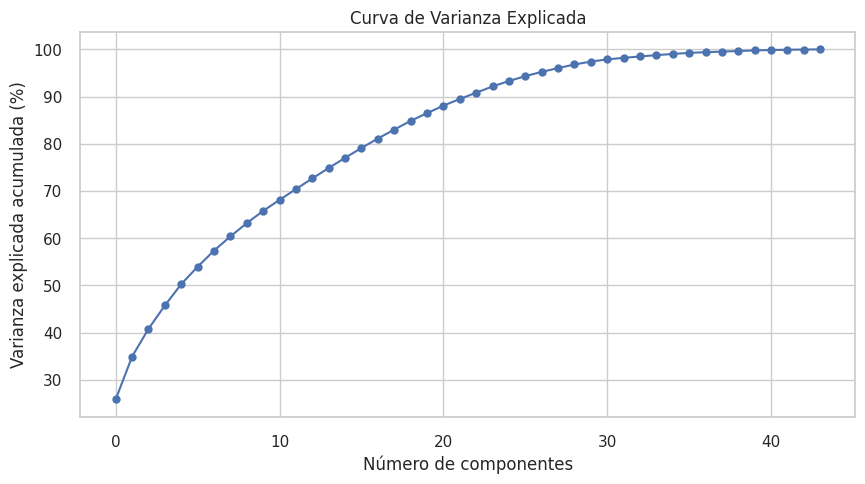

In [ ]:
scaler = StandardScaler()
df_num_out = scaler.fit_transform(df_numerico_out)

pca_full_out = PCA(n_components=df_num_out.shape[1])
pca_full_out.fit(df_num_out)

plt.figure(figsize=(10, 5))
plt.plot(np.cumsum(pca_full_out.explained_variance_ratio_) * 100, marker='o')
plt.grid(True)
plt.xlabel('Número de componentes')
plt.ylabel('Varianza explicada acumulada (%)')
plt.title('Curva de Varianza Explicada')
plt.show()

In [ ]:
i=1
for elemento in np.cumsum(pca_full_out.explained_variance_ratio_) * 100:
  if i>15 and i<35:
    print(f"{i}: {round(elemento,2)}")
  i+=1

16: 79.1
17: 81.11
18: 83.0
19: 84.85
20: 86.48
21: 88.08
22: 89.48
23: 90.83
24: 92.15
25: 93.3
26: 94.34
27: 95.23
28: 96.04
29: 96.8
30: 97.41
31: 97.89
32: 98.2
33: 98.5
34: 98.78


In [ ]:
n_out=27
pca_n_out = PCA(n_components=n_out)
componentes_n_out = pca_n_out.fit_transform(df_num_out)
cols_n_out = [f'PC{i+1}' for i in range(n_out)]
data_pca_n_out = pd.DataFrame(componentes_n_out, columns=cols_n_out)

In [ ]:
df_completo_PCA_out=pd.concat([data_pca_n_out,df_outliers[cols_binarias]],axis=1)
df_completo_PCA_out

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13,PC14,PC15,PC16,PC17,PC18,PC19,PC20,PC21,PC22,PC23,PC24,PC25,PC26,PC27,sex,cs_p12,cs_p16,cs_p17,zona,ambito1,sub_o,pnea_est,tpg_p8a,emp_ppal,tue_ppal,c_res,p2,ur,e_obs,tipolev
0,-2.423912,-0.750350,0.450857,1.290803,0.230669,1.765472,-0.565845,-0.309699,-0.201163,0.072164,0.602134,-2.095311,-1.630555,0.823483,-0.195683,-1.441947,-1.083446,0.831981,-0.115262,1.059718,0.483062,1.845040,-1.363028,-1.220919,-0.086719,0.205530,0.718286,1,1,1,0,0,0,0,0,0,0,0,1,1,1,0,1
1,-0.804928,2.551201,0.619003,3.179218,-0.499128,1.705649,2.749232,0.673452,0.288083,0.872353,-0.032863,1.946133,1.468895,-0.475110,0.016333,-0.050056,1.026308,-0.129406,0.249535,-0.102531,0.552530,-0.016103,0.828199,0.884360,-0.404897,-0.664020,0.758903,0,1,1,0,0,0,0,0,0,1,0,1,1,1,0,1
2,-0.856153,-1.196721,0.895689,-0.480250,-1.092312,1.264477,-0.361540,-0.528220,0.406454,-0.820981,-0.127914,1.432544,-0.215595,-0.287096,-0.832030,-0.698526,1.283406,1.447888,-0.216602,-0.613863,0.991646,-0.882149,0.956555,0.054291,-0.319489,-0.329880,-0.036302,0,1,0,0,0,0,0,0,0,1,0,1,1,1,0,1
3,-1.601293,1.805110,0.421942,0.026633,-0.292067,-0.918005,-2.190275,0.085713,-0.538543,-0.481594,-1.480741,0.008682,0.805002,-0.953493,-0.917307,-1.191944,1.499666,-0.414089,-1.032350,-0.301044,-0.728318,0.064608,0.443416,-0.128514,0.403329,-0.152478,0.839984,1,1,1,0,0,0,0,0,0,0,0,1,1,1,0,1
4,-2.685393,2.376055,0.468099,-1.192258,-1.517270,-2.151008,-0.377460,0.554071,0.355437,1.220047,-1.503243,0.203720,0.019410,-0.427012,-0.015558,-0.421433,0.594058,0.705612,0.907915,-0.253404,-0.530906,-0.042697,-0.398476,-0.064187,0.468164,0.963961,-0.552301,0,1,1,0,0,0,0,0,0,0,0,1,1,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
138154,9.100944,-0.730349,0.884955,-0.680780,1.480974,-0.607679,0.374875,-2.363277,0.223367,-0.750278,0.855187,1.502260,0.721195,0.359910,-0.406475,-0.555686,1.019388,0.290864,-0.672343,0.040781,-0.408466,-0.439845,-0.572785,-1.427575,0.092338,0.504014,1.170348,1,1,0,0,0,0,0,1,0,1,1,1,1,0,0,1
138155,-1.047686,-2.875667,-0.950060,1.704683,0.867270,0.370599,0.317211,-0.741754,-0.633158,1.274128,-0.454664,0.094075,-1.444739,-0.476799,1.222133,-1.651879,0.902264,-0.507261,0.223807,1.333869,1.009976,-0.054226,-1.497336,-0.407584,-0.152058,0.879182,0.543286,1,1,0,0,0,0,0,0,0,1,1,1,1,0,0,1
138156,-1.109296,-5.210096,-3.036899,2.125830,1.222735,-3.160461,1.546385,1.304467,0.857401,0.291156,-2.360741,0.380502,0.191315,1.688927,-3.459578,0.007792,0.354761,-3.815314,0.354132,-6.515725,2.456025,-0.376405,-3.963175,-0.826788,0.800112,0.593738,0.582920,1,0,0,0,0,1,1,0,1,1,0,1,1,0,0,1
138157,0.008461,-3.678092,-0.347948,0.515282,-0.908209,0.819403,1.433475,-0.169995,1.104437,0.336520,1.090973,0.493426,-2.403781,0.601592,1.104648,-1.042669,0.047421,-1.178484,0.569501,0.291023,-0.954336,-1.133187,-0.220664,1.067653,-0.344844,0.326063,0.888358,1,1,0,0,0,0,1,0,0,1,1,1,1,0,0,1


#Numero de clusters

##Sin outliers

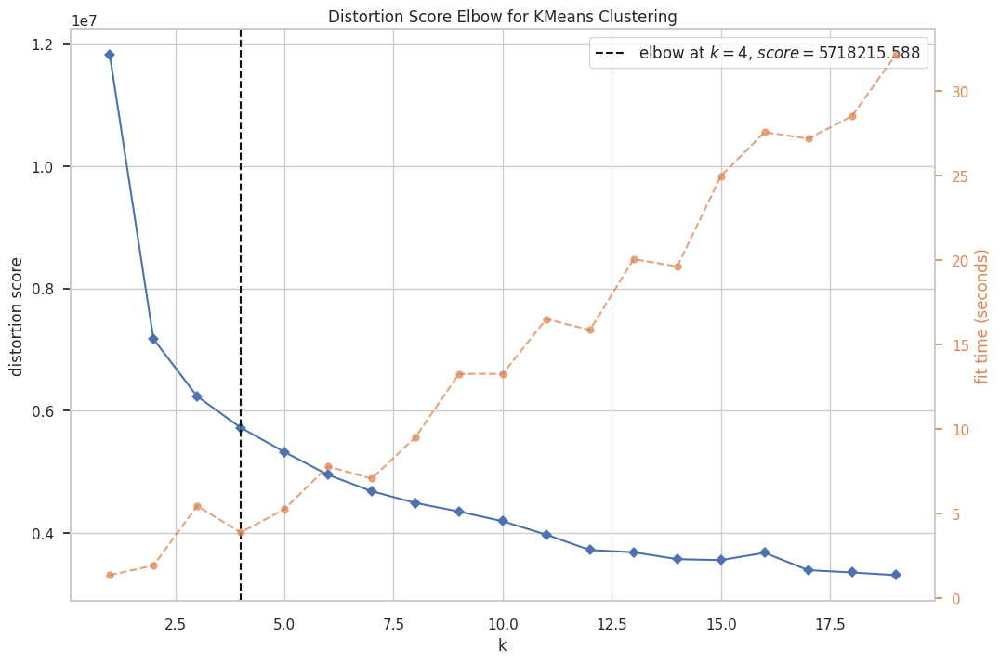

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [ ]:
iteraciones=20
model = KMeans(n_clusters=i, init='k-means++', n_init=10, random_state=31)
visualizer = KElbowVisualizer(model, k=(1,iteraciones)).fit(df_completo_PCA)
visualizer.show()

##Con outliers

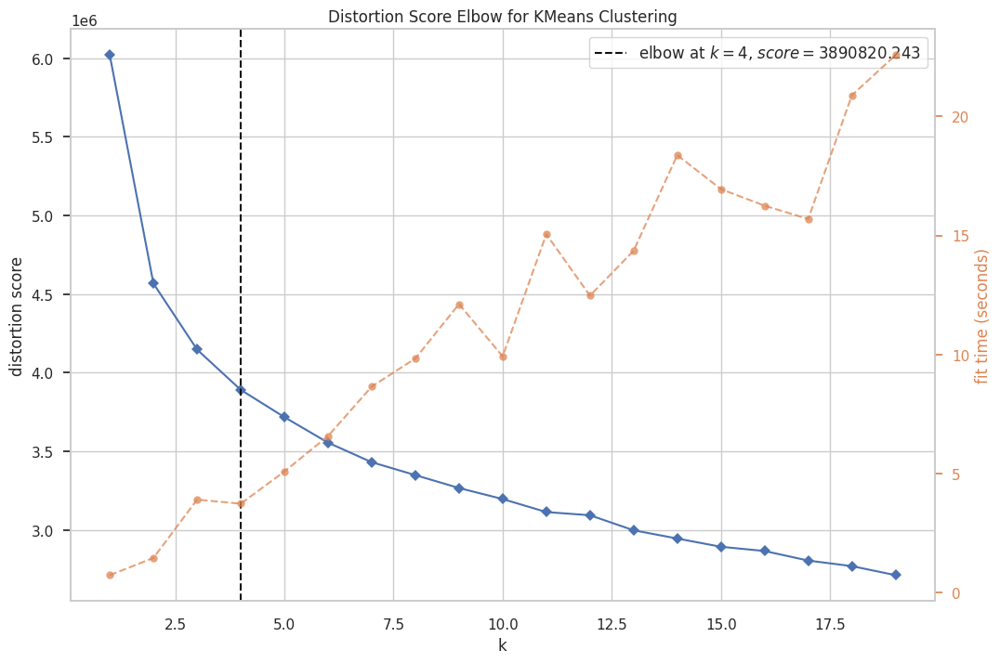

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [ ]:
iteraciones=20
model = KMeans(n_clusters=i, init='k-means++', n_init=10,random_state=31)
visualizer = KElbowVisualizer(model, k=(1,iteraciones)).fit(df_completo_PCA_out)
visualizer.show()

#Clusterizacion

##Sin outliers

###Kmeans

In [ ]:
kmeans_final = KMeans(
    n_clusters=4,
    random_state=31,
    n_init='auto'
)
kmeans_final.fit(df_completo_PCA)

KMeans(n_clusters=4, random_state=31)

In [ ]:
etiquetas_cluster = kmeans_final.labels_
df_limpio['Cluster_k'] = etiquetas_cluster
df_limpio['Cluster_k'].value_counts()


,count
Cluster_k,
3,76362
2,71817
1,64741
0,60477


###Gaussiano

In [ ]:
gmm = GMM(n_components=4,random_state=31,).fit(df_completo_PCA)
labels = gmm.predict(df_completo_PCA)
df_limpio['Cluster_GMM'] = labels
df_limpio['Cluster_GMM'].value_counts()

,count
Cluster_GMM,
3,90346
2,71843
1,63753
0,47455


##Con outliers

###Kmeans

In [ ]:
kmeans_final = KMeans(
    n_clusters=4,
    random_state=31,
    n_init='auto'
)
kmeans_final.fit(df_completo_PCA_out)

KMeans(n_clusters=4, random_state=31)

In [ ]:
etiquetas_cluster = kmeans_final.labels_
df_outliers['Cluster_k_out'] = etiquetas_cluster
df_outliers['Cluster_k_out'].value_counts()


,count
Cluster_k_out,
1,64390
0,55992
3,12586
2,5191


###Gaussiano

In [ ]:
gmm = GMM(n_components=4,random_state=31,).fit(df_completo_PCA_out)
labels = gmm.predict(df_completo_PCA_out)
df_outliers['Cluster_GMM_out'] = labels
df_outliers['Cluster_GMM_out'].value_counts()

,count
Cluster_GMM_out,
1,77887
0,42495
3,12586
2,5191


#Graficar PCA

##Sin outliers

###2D

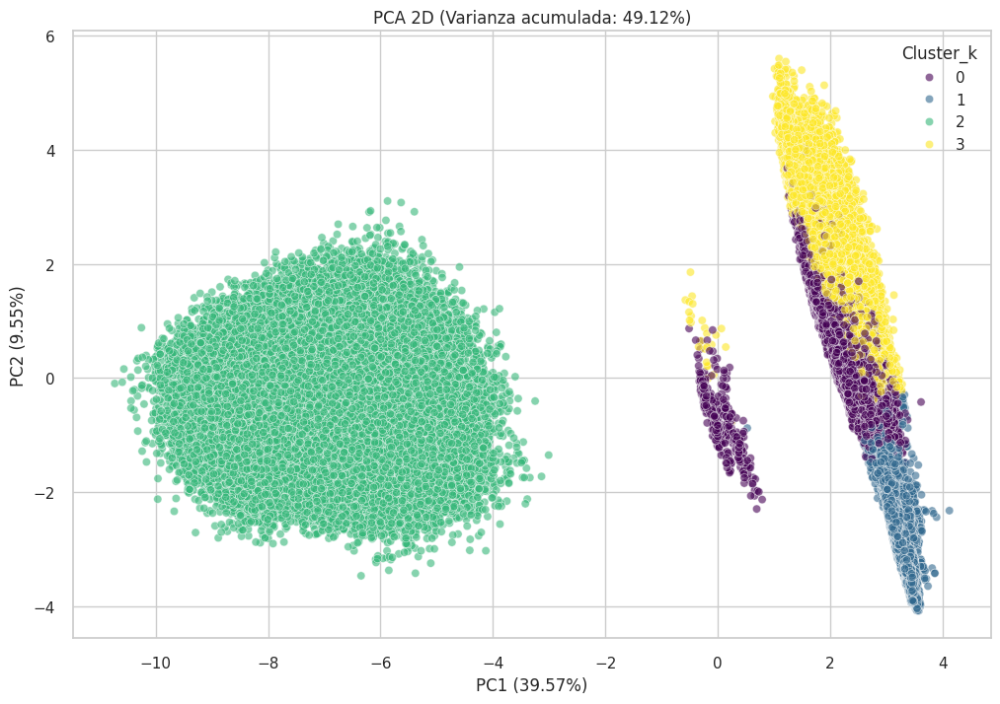

In [ ]:
sns.scatterplot(
    data=data_pca_n,
    x='PC1',
    y='PC2',
    hue=df_limpio['Cluster_k'],
    palette='viridis',
    alpha=0.6
)
var_2d = sum(pca_n.explained_variance_ratio_[0:2]) * 100
plt.title(f'PCA 2D (Varianza acumulada: {var_2d:.2f}%)')
plt.xlabel(f'PC1 ({pca_n.explained_variance_ratio_[0]*100:.2f}%)')
plt.ylabel(f'PC2 ({pca_n.explained_variance_ratio_[1]*100:.2f}%)')
plt.grid(True)
plt.show()

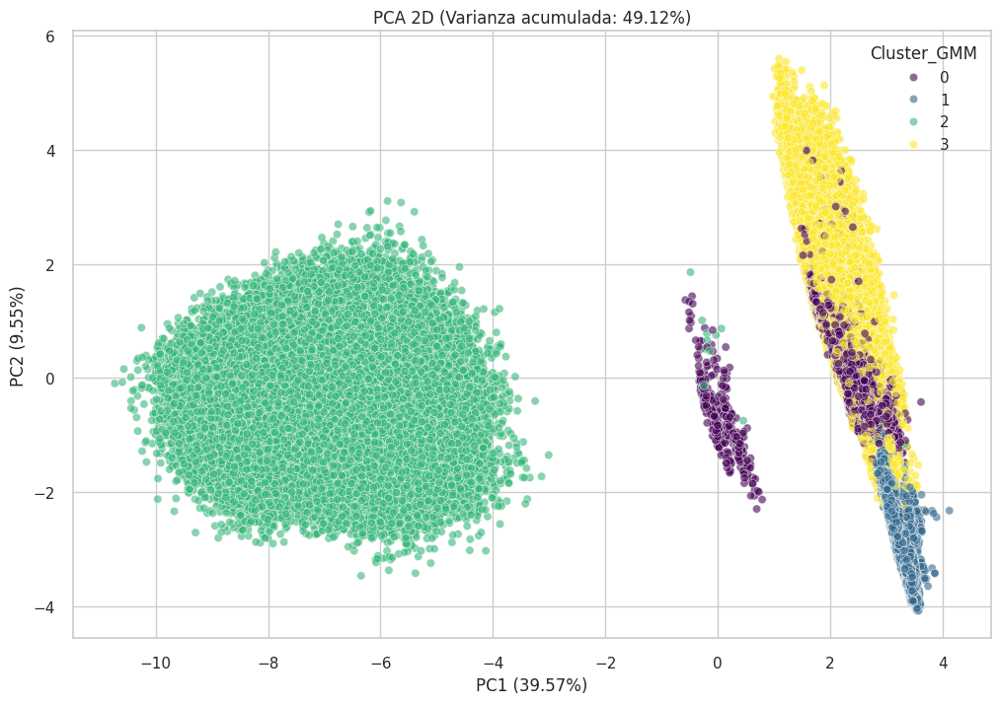

In [ ]:
sns.scatterplot(
    data=data_pca_n,
    x='PC1',
    y='PC2',
    hue=df_limpio['Cluster_GMM'],
    palette='viridis',
    alpha=0.6
)
var_2d = sum(pca_n.explained_variance_ratio_[0:2]) * 100
plt.title(f'PCA 2D (Varianza acumulada: {var_2d:.2f}%)')
plt.xlabel(f'PC1 ({pca_n.explained_variance_ratio_[0]*100:.2f}%)')
plt.ylabel(f'PC2 ({pca_n.explained_variance_ratio_[1]*100:.2f}%)')
plt.grid(True)
plt.show()

###3D

In [ ]:
temp_df = data_pca_n.copy()
temp_df['Cluster_k'] = df_limpio['Cluster_k'].values
df_sample = temp_df.sample(frac=0.4, random_state=31)

var_3d = sum(pca_n.explained_variance_ratio_[0:3]) * 100

fig = px.scatter_3d(
    df_sample,
    x='PC1',
    y='PC2',
    z='PC3',
    color='Cluster_k',
    title=f'PCA 3D (Varianza acumulada: {var_3d:.2f}%)',
    opacity=1
)

fig.update_traces(marker=dict(size=3))
fig.update_layout(width=900, height=900)
fig.show()

In [ ]:
temp_df = data_pca_n.copy()
temp_df['Cluster_GMM'] = df_limpio['Cluster_GMM'].values
df_sample = temp_df.sample(frac=0.4, random_state=31)

var_3d = sum(pca_n.explained_variance_ratio_[0:3]) * 100

fig = px.scatter_3d(
    df_sample,
    x='PC1',
    y='PC2',
    z='PC3',
    color='Cluster_GMM',
    title=f'PCA 3D (Varianza acumulada: {var_3d:.2f}%)',
    opacity=1
)

fig.update_traces(marker=dict(size=3))
fig.update_layout(width=900, height=900)
fig.show()

##Con_outliers

###2D

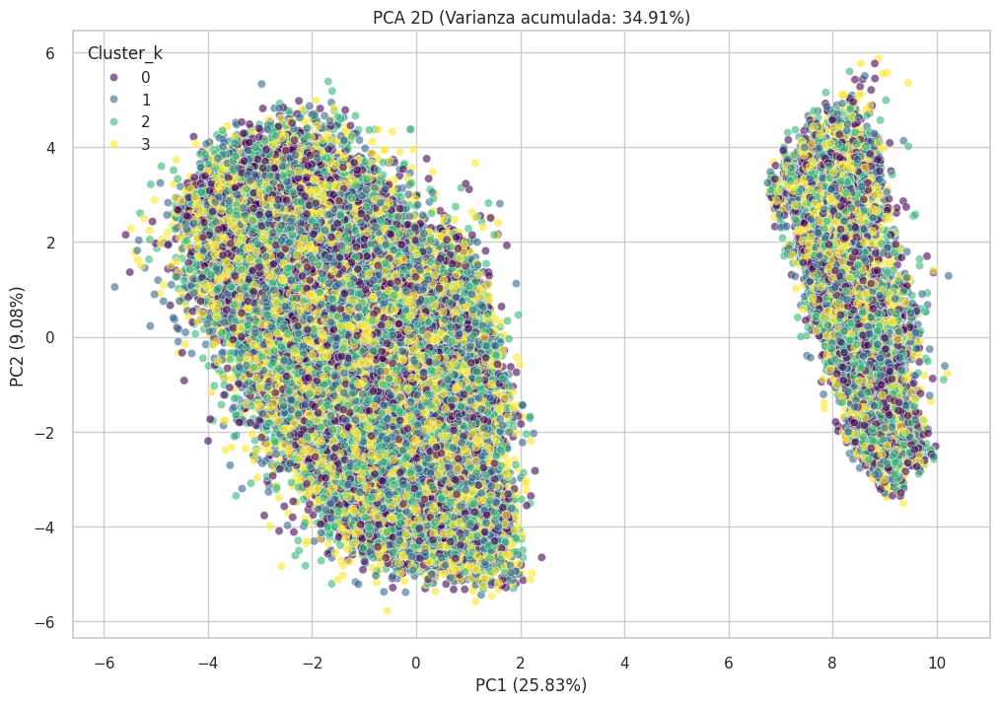

In [ ]:
sns.scatterplot(
    data=data_pca_n_out,
    x='PC1',
    y='PC2',
    hue=df_limpio['Cluster_k'],
    palette='viridis',
    alpha=0.6
)
var_2d = sum(pca_n_out.explained_variance_ratio_[0:2]) * 100
plt.title(f'PCA 2D (Varianza acumulada: {var_2d:.2f}%)')
plt.xlabel(f'PC1 ({pca_n_out.explained_variance_ratio_[0]*100:.2f}%)')
plt.ylabel(f'PC2 ({pca_n_out.explained_variance_ratio_[1]*100:.2f}%)')
plt.grid(True)
plt.show()

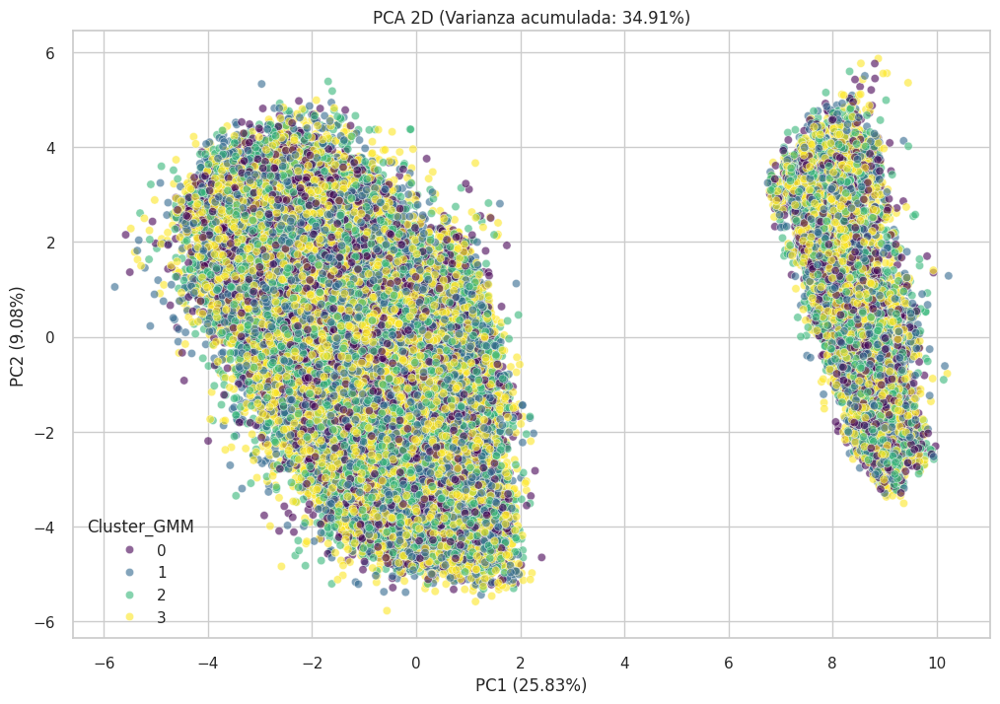

In [ ]:
sns.scatterplot(
    data=data_pca_n_out,
    x='PC1',
    y='PC2',
    hue=df_limpio['Cluster_GMM'],
    palette='viridis',
    alpha=0.6
)
var_2d = sum(pca_n_out.explained_variance_ratio_[0:2]) * 100
plt.title(f'PCA 2D (Varianza acumulada: {var_2d:.2f}%)')
plt.xlabel(f'PC1 ({pca_n_out.explained_variance_ratio_[0]*100:.2f}%)')
plt.ylabel(f'PC2 ({pca_n_out.explained_variance_ratio_[1]*100:.2f}%)')
plt.grid(True)
plt.show()

###3D

In [ ]:
temp_df = data_pca_n_out.copy()
temp_df['Cluster_k_out'] = df_outliers['Cluster_k_out'].values
df_sample = temp_df.sample(frac=0.4, random_state=31)

var_3d = sum(pca_n_out.explained_variance_ratio_[0:3]) * 100

fig = px.scatter_3d(
    df_sample,
    x='PC1',
    y='PC2',
    z='PC3',
    color='Cluster_k_out',
    title=f'PCA 3D (Varianza acumulada: {var_3d:.2f}%)',
    opacity=1
)

fig.update_traces(marker=dict(size=3))
fig.update_layout(width=900, height=900)
fig.show()

In [ ]:
temp_df = data_pca_n_out.copy()
temp_df['Cluster_GMM_out'] = df_outliers['Cluster_GMM_out'].values
df_sample = temp_df.sample(frac=0.4, random_state=31)

var_3d = sum(pca_n_out.explained_variance_ratio_[0:3]) * 100

fig = px.scatter_3d(
    df_sample,
    x='PC1',
    y='PC2',
    z='PC3',
    color='Cluster_GMM_out',
    title=f'PCA 3D (Varianza acumulada: {var_3d:.2f}%)',
    opacity=1
)

fig.update_traces(marker=dict(size=3))
fig.update_layout(width=900, height=900)
fig.show()

cs_p13_1      0.358174
p4_1          0.345635
p4_2          0.345600
n_hij        -0.330607
anios_esc     0.303028
e_con_frec    0.292543
niv_ins       0.282050
par_c_frec    0.269302
eda          -0.217583
t_loc_tri    -0.187854
Name: PC3, dtype: float64


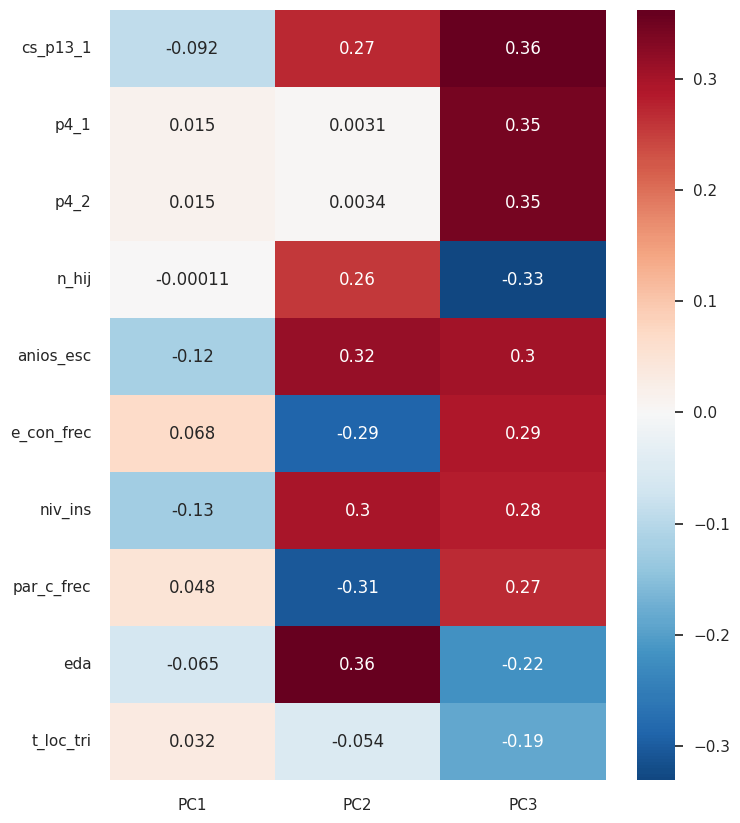

In [ ]:
df_anzalizar=df_numerico
pc_num='PC3'

nombres_variables = df_anzalizar.columns
loadings = pd.DataFrame(
    pca_n.components_.T,
    columns=cols_n,
    index=nombres_variables
)
top_pc = loadings[pc_num].abs().sort_values(ascending=False).head(10)
print(loadings.loc[top_pc.index, pc_num])
plt.figure(figsize=(8, 10))
sns.heatmap(loadings.loc[top_pc.index, ['PC1', 'PC2', 'PC3']],
            annot=True, cmap='RdBu_r', center=0)
plt.show()

#Graficar TSNE

In [ ]:
df_num = df_completo_PCA.copy()

np.random.seed(31)
if df_num.shape[0] > 10000:
    sample_indices = np.random.choice(np.arange(df_num.shape[0]), size=40000, replace=False)
    df_tsne_input = df_num.iloc[sample_indices]
    cluster_labels = df_limpio.loc[sample_indices, 'Cluster_k'].reset_index(drop=True)
else:
    df_tsne_input = df_num
    cluster_labels = df_limpio['Cluster_k'].reset_index(drop=True)

tsne_2d = TSNE(n_components=2,
               random_state=31,
               n_jobs=-1,
               verbose=1)

comp_2d = tsne_2d.fit_transform(df_tsne_input)

data_tsne_2d = pd.DataFrame(comp_2d, columns=['C1', 'C2'])

data_tsne_2d['Cluster_k'] = cluster_labels

fig_tsne_2d = px.scatter(data_tsne_2d,
                         x='C1', y='C2',
                         color='Cluster_k',
                         title='Visualización de t-SNE (2 Componentes)',
                         labels={'C1': 'Componente t-SNE 1', 'C2': 'Componente t-SNE 2'},
                         opacity=0.8,
                         height=700)

fig_tsne_2d.update_traces(marker=dict(size=5))
fig_tsne_2d.update_layout(showlegend=True)
fig_tsne_2d.show()

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 40000 samples in 0.030s...
[t-SNE] Computed neighbors for 40000 samples in 14.326s...
[t-SNE] Computed conditional probabilities for sample 1000 / 40000
[t-SNE] Computed conditional probabilities for sample 2000 / 40000
[t-SNE] Computed conditional probabilities for sample 3000 / 40000
[t-SNE] Computed conditional probabilities for sample 4000 / 40000
[t-SNE] Computed conditional probabilities for sample 5000 / 40000
[t-SNE] Computed conditional probabilities for sample 6000 / 40000
[t-SNE] Computed conditional probabilities for sample 7000 / 40000
[t-SNE] Computed conditional probabilities for sample 8000 / 40000
[t-SNE] Computed conditional probabilities for sample 9000 / 40000
[t-SNE] Computed conditional probabilities for sample 10000 / 40000
[t-SNE] Computed conditional probabilities for sample 11000 / 40000
[t-SNE] Computed conditional probabilities for sample 12000 / 40000
[t-SNE] Computed conditional probabilities for sa

In [ ]:
df_num = df_completo_PCA_out.copy()

np.random.seed(31)
if df_num.shape[0] > 10000:
    sample_indices = np.random.choice(np.arange(df_num.shape[0]), size=40000, replace=False)
    df_tsne_input = df_num.iloc[sample_indices]
    cluster_labels = df_outliers.loc[sample_indices, 'Cluster_k_out'].reset_index(drop=True)
else:
    df_tsne_input = df_num
    cluster_labels = df_outliers['Cluster_k_out'].reset_index(drop=True)

tsne_2d = TSNE(n_components=2,
               random_state=31,
               n_jobs=-1,
               verbose=1)

comp_2d = tsne_2d.fit_transform(df_tsne_input)

data_tsne_2d = pd.DataFrame(comp_2d, columns=['C1', 'C2'])

data_tsne_2d['Cluster_k'] = cluster_labels

fig_tsne_2d = px.scatter(data_tsne_2d,
                         x='C1', y='C2',
                         color='Cluster_k',
                         title='Visualización de t-SNE (2 Componentes)',
                         labels={'C1': 'Componente t-SNE 1', 'C2': 'Componente t-SNE 2'},
                         opacity=0.8,
                         height=700)

fig_tsne_2d.update_traces(marker=dict(size=5))
fig_tsne_2d.update_layout(showlegend=True)
fig_tsne_2d.show()

[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 40000 samples in 0.026s...
[t-SNE] Computed neighbors for 40000 samples in 16.183s...
[t-SNE] Computed conditional probabilities for sample 1000 / 40000
[t-SNE] Computed conditional probabilities for sample 2000 / 40000
[t-SNE] Computed conditional probabilities for sample 3000 / 40000
[t-SNE] Computed conditional probabilities for sample 4000 / 40000
[t-SNE] Computed conditional probabilities for sample 5000 / 40000
[t-SNE] Computed conditional probabilities for sample 6000 / 40000
[t-SNE] Computed conditional probabilities for sample 7000 / 40000
[t-SNE] Computed conditional probabilities for sample 8000 / 40000
[t-SNE] Computed conditional probabilities for sample 9000 / 40000
[t-SNE] Computed conditional probabilities for sample 10000 / 40000
[t-SNE] Computed conditional probabilities for sample 11000 / 40000
[t-SNE] Computed conditional probabilities for sample 12000 / 40000
[t-SNE] Computed conditional probabilities for sa

#Perfilamiento

In [ ]:
indices

['cve_ent', 'con', 'v_sel', 'tipo', 'n_hog', 'h_mud', 'n_ren']

In [ ]:
df = df.set_index(indices)
df_limpio = df_limpio.set_index(indices)
df_outliers = df_outliers.set_index(indices)


In [ ]:
df['k'] = df_limpio['Cluster_k']

In [ ]:
df['ko']=df_outliers['Cluster_k_out']

In [ ]:
df['ko'].isna().sum()

np.int64(273397)

##Categoricas

In [ ]:
columnas_categoricas

['par_c',
 'nac_origen',
 'cs_p14_c',
 'e_con',
 'cs_p20a_1',
 'clase1',
 'clase2',
 'clase3',
 'pos_ocu',
 'seg_soc',
 'rama',
 'c_ocu11c',
 'medica5c',
 'buscar5c',
 's_clasifi',
 'tue1',
 'tue2',
 'tue3',
 'busqueda',
 'c_inac5c',
 'domestico',
 'imssissste',
 'scian',
 'sec_ins',
 'est',
 'est_d_tri',
 'Map_cd_a',
 'Map_cve_ent']

###Limpio

In [ ]:
for columna in columnas_categoricas:
    df_perfilamiento = df.dropna(subset=['k',columna]).copy()
    tabla_frecuencias = pd.crosstab(
        df_perfilamiento['k'],
        df_perfilamiento[columna]
    )
    porcentajes_fila = (tabla_frecuencias.div(tabla_frecuencias.sum(axis=1), axis=0) *100).round(1)
    display(porcentajes_fila)

par_c,Conyuge_Pareja,Familia_Extensa,Hijos_Nietos,Jefe_Hogar,Sin_Parentesco
k,,,,,
0.0,0.0,2.1,94.8,2.8,0.2
1.0,0.0,1.7,98.0,0.1,0.2
2.0,18.6,3.6,32.9,44.6,0.2
3.0,47.4,10.8,2.8,38.6,0.4


nac_origen,Asia_Africa_Resto,EUA_Canada,Europa,Latam,Local,Otro_Estado
k,,,,,,
0.0,0.0,0.9,0.0,0.1,90.6,8.3
1.0,0.0,0.7,0.0,0.1,92.9,6.3
2.0,0.0,0.0,0.0,0.1,90.0,9.8
3.0,0.0,0.2,0.0,0.2,78.8,20.8


cs_p14_c,0,11,12,21,22,31,32,33,41,42,51,52,53,61,62,71,72,73,81,82,91,92,93,94,95,101,102,103,104,999
k,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0.0,84.5,0.6,0.8,0.6,0.3,1.1,0.2,1.2,1.5,1.3,0.4,0.1,0.1,0.7,0.2,1.9,0.1,0.8,0.2,0.2,0.9,0.8,0.4,0.5,0.1,0.6,0.0,0.0,0.0,0.1
1.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2.0,84.1,0.4,0.5,0.5,0.1,1.0,0.2,1.2,2.6,2.0,0.2,0.1,0.0,0.9,0.5,2.3,0.1,0.5,0.1,0.1,0.1,0.5,0.2,0.3,0.1,1.2,0.0,0.0,0.0,0.1
3.0,84.1,0.8,2.1,0.2,0.1,1.0,0.1,0.9,2.3,1.2,0.2,0.1,0.0,0.3,0.3,1.0,0.1,0.4,0.2,0.0,0.3,1.0,0.2,0.1,0.1,2.6,0.0,0.0,0.0,0.1


e_con,1.0,2.0,3.0,4.0,5.0,6.0
k,,,,,,
0.0,1.3,0.2,0.0,0.0,2.5,95.9
1.0,0.0,0.0,0.0,0.0,0.1,99.9
2.0,19.8,4.9,1.8,1.9,36.7,34.9
3.0,19.5,5.0,2.2,12.6,54.2,6.5


cs_p20a_1,1.0,2.0,3.0,4.0
k,,,,
0.0,99.7,0.2,0.0,0.0
1.0,99.8,0.2,0.0,0.0
2.0,99.9,0.1,0.0,0.0
3.0,99.8,0.1,0.0,0.0


clase1,0,1,2
k,,,
0.0,0.0,0.8,99.2
1.0,98.5,0.0,1.5
2.0,0.0,100.0,0.0
3.0,0.0,0.0,100.0


clase2,0,1,2,3,4
k,,,,,
0.0,0.0,0.0,0.8,10.3,88.8
1.0,98.5,0.0,0.0,0.3,1.3
2.0,0.0,100.0,0.0,0.0,0.0
3.0,0.0,0.0,0.0,9.9,90.1


clase3,0,1,2,3,4,5,6,7
k,,,,,,,,
0.0,99.2,0.0,0.0,0.0,0.0,0.0,0.8,0.0
1.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2.0,0.0,99.2,0.6,0.0,0.2,0.0,0.0,0.0
3.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


pos_ocu,0,1,2,3,4
k,,,,,
0.0,100.0,0.0,0.0,0.0,0.0
1.0,100.0,0.0,0.0,0.0,0.0
2.0,0.0,65.2,3.9,28.0,3.0
3.0,100.0,0.0,0.0,0.0,0.0


seg_soc,0,1,2,3
k,,,,
0.0,100.0,0.0,0.0,0.0
1.0,100.0,0.0,0.0,0.0
2.0,0.0,32.0,67.9,0.1
3.0,100.0,0.0,0.0,0.0


rama,0,1,2,3,4,5,6,7
k,,,,,,,,
0.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2.0,0.0,9.0,15.5,28.5,42.3,0.1,4.6,0.0
3.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


c_ocu11c,0,1,2,3,4,5,6,7,8,9,10,11
k,,,,,,,,,,,,
0.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2.0,0.0,7.4,0.3,0.8,7.2,28.6,26.5,5.8,18.6,0.1,4.6,0.1
3.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


medica5c,0,1,2,3,4,5
k,,,,,,
0.0,100.0,0.0,0.0,0.0,0.0,0.0
1.0,100.0,0.0,0.0,0.0,0.0,0.0
2.0,0.0,61.9,0.6,31.4,5.6,0.5
3.0,100.0,0.0,0.0,0.0,0.0,0.0


buscar5c,0,1,2,3,4,5
k,,,,,,
0.0,100.0,0.0,0.0,0.0,0.0,0.0
1.0,100.0,0.0,0.0,0.0,0.0,0.0
2.0,0.0,0.0,0.2,0.3,99.4,0.0
3.0,100.0,0.0,0.0,0.0,0.0,0.0


s_clasifi,0,2,3,4,5
k,,,,,
0.0,100.0,0.0,0.0,0.0,0.0
1.0,100.0,0.0,0.0,0.0,0.0
2.0,97.4,2.3,0.0,0.0,0.2
3.0,100.0,0.0,0.0,0.0,0.0


tue1,0,1,2,3
k,,,,
0.0,100.0,0.0,0.0,0.0
1.0,100.0,0.0,0.0,0.0
2.0,0.0,53.0,0.3,46.7
3.0,100.0,0.0,0.0,0.0


tue2,0,1,2,3,4,5,6,7
k,,,,,,,,
0.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2.0,0.0,29.2,23.8,0.3,0.0,42.2,4.1,0.4
3.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


tue3,0,2
k,,
0.0,100.0,0.0
1.0,100.0,0.0
2.0,100.0,0.0
3.0,100.0,0.0


busqueda,0,1,2
k,,,
0.0,100.0,0.0,0.0
1.0,100.0,0.0,0.0
2.0,0.0,0.0,100.0
3.0,100.0,0.0,0.0


c_inac5c,0,1,2,3,4,5
k,,,,,,
0.0,0.8,77.7,14.3,1.1,0.9,5.2
1.0,98.5,0.1,0.6,0.0,0.5,0.3
2.0,100.0,0.0,0.0,0.0,0.0,0.0
3.0,0.0,0.6,69.6,18.4,0.7,10.6


domestico,0,1,2,3,4,5,6,7,8,9,10
k,,,,,,,,,,,
0.0,0.0,0.2,0.1,0.5,0.1,0.0,6.3,38.4,52.5,1.8,0.2
1.0,98.5,0.0,0.0,0.0,0.0,0.0,0.6,0.1,0.8,0.0,0.0
2.0,0.0,7.3,1.4,85.4,5.3,0.5,0.0,0.0,0.0,0.0,0.0
3.0,0.0,0.0,0.0,0.0,0.0,0.0,6.7,0.3,90.6,2.2,0.2


imssissste,0,1,2,3,4,5
k,,,,,,
0.0,100.0,0.0,0.0,0.0,0.0,0.0
1.0,100.0,0.0,0.0,0.0,0.0,0.0
2.0,0.0,31.9,0.0,0.1,67.9,0.1
3.0,100.0,0.0,0.0,0.0,0.0,0.0


scian,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,21
k,,,,,,,,,,,,,,,,,,,,,
0.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2.0,0.0,4.6,0.1,0.0,9.0,15.5,3.4,25.1,6.2,0.7,0.7,0.7,2.4,0.1,3.3,0.4,1.3,0.8,13.7,11.8,0.0
3.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


sec_ins,0,1,2,3,4,6,7,8,9,10
k,,,,,,,,,,
0.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2.0,0.0,0.7,28.6,4.2,19.6,0.3,0.0,42.2,4.1,0.4
3.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


est,1,2,3,4
k,,,,
0.0,14.4,44.7,27.8,13.1
1.0,21.1,48.0,22.3,8.6
2.0,12.9,47.6,30.5,9.0
3.0,15.0,45.2,28.0,11.9


est_d_tri,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021,1022,1023,1024,1025,1026,1027,1028,1029,1030,1031,1032,1033,1034,1035,1036,1037,1038,1039,1040,1041,1042,1043,1044,1045,1046,1047,1048,1049,1050,1051,1052,1053,1054,1055,1056,1057,1058,1059,1060,1061,1062,1063,1064,1065,1066,1067,1068,1069,1070,1071,1072,1073,1074,1075,1076,1077,1078,1079,1080,1081,1082,1083,1084,1085,1086,1087,1088,1089,1090,1091,1092,1093,1094,1095,1096,1097,1098,1099,1100,1101,1102,1103,1104,1105,1106,1107,1108,1109,1110,1111,1112,1113,1114,1115,1116,1117,1118,1119,1120,1121,1122,1123,1124,1125,1126,1127,1128,1129,1130,1131,1132,1133,1134,1135,1136,1137,1138,1139,1140,1141,1142,1143,1144,1145,1146,1147,1148,1149,1150,1151,1152,1153,1154,1155,1156,1157,1158,1159,1160,1161,1162,1163,1164,1165,1166,1167,1168,1169,1170,1171,1172,1173,1174,1175,1176,1177,1178,1179,1180,1182,1183,1184,1185,1186,1187,1188,1189,1190,1191,1192,1193,1194,1195,1196,1197,1198,1199,1200,1201,1202,1203,1204,1205,1206,1207,1208,1209,1210,1211,1212,1213,1214,1215,1216,1217,1218,1219,1220,1221,1222,1223,1224,1225,1226,1227,1228,1229,1230,1231,1232,1233,1234,1235,1236,1237,1238,1239,1240,1241,1242,1243,1244,1245
k,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0.0,0.0,0.6,0.5,0.3,0.1,0.0,

Map_cd_a,Acapulco,Aguascalientes,Campeche,Cancún,Chihuahua,Ciudad Juárez,Ciudad del Carmen,Coatzacoalcos,Colima,Complemento urbano-Rural,Cuernavaca,Culiacán,Durango,Guadalajara,Hermosillo,La Paz,León,Mexicali,Monterrey,Morelia,Mérida,México,Oaxaca,Pachuca,Puebla,Querétaro,Reynosa,Saltillo,San Luis Potosí,Tampico,Tapachula,Tepic,Tijuana,Tlaxcala,Toluca,Torreón,Tuxtla Gutiérrez,Veracruz,Villahermosa,Zacatecas
k,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0.0,1.5,1.7,1.5,1.3,1.5,1.7,1.5,1.3,1.2,34.2,1.6,1.7,1.9,2.5,1.5,1.1,2.1,1.4,2.3,1.5,1.3,3.9,1.7,1.4,2.3,1.4,1.5,1.7,1.7,1.3,1.7,1.4,1.8,1.9,2.0,2.2,1.5,1.2,1.5,1.6
1.0,1.3,1.6,1.0,1.3,1.2,1.6,1.3,1.0,1.2,42.5,1.2,1.3,1.7,2.2,1.3,0.9,2.6,1.1,2.1,1.2,1.2,2.7,1.3,1.0,1.9,1.2,1.5,1.8,1.6,1.1,1.6,1.5,1.5,1.9,1.4,2.3,1.3,0.9,1.2,1.4
2.0,1.8,1.9,1.5,1.0,2.0,1.5,0.9,1.2,1.6,28.4,2.1,1.7,2.1,3.1,1.9,1.1,2.7,1.5,2.4,1.7,2.0,4.1,2.1,1.3,3.1,1.7,1.4,1.6,1.8,1.6,1.6,1.6,1.6,2.3,1.7,2.6,1.5,1.3,1.4,1.5
3.0,1.6,1.5,1.5,1.2,1.5,1.5,1.3,1.6,1.3,37.5,1.7,1.4,1.5,2.5,1.3,1.1,1.8,1.4,2.4,1.3,1.4,3.8,1.4,1.3,2.1,1.4,1.5,1.8,1.5,1.6,1.4,1.3,1.5,1.8,1.7,2.0,1.4,1.4,1.4,1.4


Map_cve_ent,Aguascalientes,Baja California,Baja California Sur,Campeche,Chiapas,Chihuahua,Ciudad de México,Coahuila,Colima,Durango,Guanajuato,Guerrero,Hidalgo,Jalisco,Michoacán,Morelos,México,Nayarit,Nuevo León,Oaxaca,Puebla,Querétaro,Quintana Roo,San Luis Potosí,Sinaloa,Sonora,Tabasco,Tamaulipas,Tlaxcala,Veracruz,Yucatán,Zacatecas
k,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0.0,3.0,4.0,1.9,3.9,5.0,3.8,2.2,3.8,2.1,3.4,3.4,2.9,2.4,3.5,2.7,2.8,4.9,2.4,3.1,3.4,3.6,2.7,2.0,2.9,2.7,2.6,2.8,3.8,2.9,4.2,2.2,2.9
1.0,3.1,3.5,1.8,3.5,5.7,3.5,1.5,4.2,2.3,3.6,4.1,3.4,2.2,3.3,2.9,2.3,3.9,3.0,3.1,3.6,3.7,2.7,2.3,3.1,2.5,2.5,2.8,3.5,3.2,3.8,2.6,3.0
2.0,2.7,3.6,1.5,3.1,4.0,3.9,2.3,3.9,2.4,3.5,3.8,3.1,2.2,4.1,3.0,3.4,4.4,2.7,2.9,3.3,4.7,2.9,1.5,2.7,2.5,2.8,2.4,3.7,3.4,3.8,3.2,2.6
3.0,2.9,3.7,1.7,3.7,4.7,3.7,2.1,4.1,2.2,3.1,3.4,3.2,2.5,3.7,2.8,2.9,4.5,2.4,3.2,3.3,3.5,2.6,1.9,3.0,2.7,2.4,2.8,4.1,2.8,5.3,2.3,3.0


General
- Ninguno trabaja en el gobieron

Cluster 0
- Esta compuesta por los hijos y nietos
- Están solteros
- Población no económicamente activa
- En su mayoría No disponibles
- Son estudiantes
- PNEA y quehaceres domésticos
- PNEA y estudian

Cluster 1
- Esta compuesta por los hijos y nietos
- En su código de carrera están vacíos
- Están solteros
- No aplica


Cluster 2
- Esta compuesta por lo hijos/nietos, por lo jefes de hogar y ligeramente por la pareja
- Están solteros, casados o menor medida viven con su pareja en unión libre
- Población económicamente activa
- tiene valores en trabajadores subordinados y remunerados
- dos terceras partes no reciben atención medica y la otra tercera parte la recibe del
- Tienen mucha variabilidad en las actividades económicas del país.
- Población ocupada

Cluster 3
- Están compuesto de las parejas cónyuges y de la persona jefa del hogar
- El 20% de ellas han nacido de otro estado
- Están casados o en menor medida viven con su pareja en unión libre o están viudos
- Población no económicamente activa
- No disponibles
- Quehaceres domésticos o en menor medida son pensionados y jubilados


###Ourlier

In [ ]:
for columna in columnas_categoricas:
    df_perfilamiento = df.dropna(subset=['ko',columna]).copy()
    tabla_frecuencias = pd.crosstab(
        df_perfilamiento['ko'],
        df_perfilamiento[columna]
    )
    porcentajes_fila = (tabla_frecuencias.div(tabla_frecuencias.sum(axis=1), axis=0) *100).round(1)
    display(porcentajes_fila)

par_c,Conyuge_Pareja,Familia_Extensa,Hijos_Nietos,Jefe_Hogar,Sin_Parentesco,Trabajador_Domestico
ko,,,,,,
0.0,17.9,9.1,24.3,47.9,0.7,0.2
1.0,18.7,7.1,28.3,44.7,1.0,0.1
2.0,11.9,7.9,52.2,27.1,1.0,0.0
3.0,20.0,20.0,19.4,39.2,1.3,0.1


nac_origen,Asia_Africa_Resto,EUA_Canada,Europa,Latam,Local,Otro_Estado
ko,,,,,,
0.0,0.1,0.5,0.0,0.6,74.5,24.4
1.0,0.1,0.4,0.1,0.4,71.1,27.9
2.0,0.1,0.7,0.0,0.8,78.1,20.3
3.0,0.2,2.9,0.3,1.9,47.8,46.9


cs_p14_c,0,11,12,21,22,31,32,33,41,42,51,52,53,61,62,71,72,73,81,82,91,92,93,94,95,101,102,103,104,999
ko,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0.0,90.2,0.4,0.5,0.3,0.1,0.5,0.1,0.7,1.3,0.8,0.2,0.0,0.0,0.4,0.2,1.3,0.1,0.4,0.4,0.2,0.1,0.4,0.1,0.2,0.1,1.0,0.0,0.0,0.0,0.1
1.0,35.3,4.0,4.9,1.4,0.9,3.8,0.8,5.8,7.3,7.1,0.9,0.4,0.2,2.9,1.3,7.9,0.6,2.9,0.9,0.4,1.9,3.4,0.8,0.8,0.5,2.3,0.1,0.0,0.1,0.3
2.0,58.5,2.1,1.7,1.4,0.6,2.8,0.5,3.7,4.5,4.5,0.8,0.3,0.1,1.9,0.9,6.8,0.8,2.2,0.4,0.1,0.5,1.4,0.5,0.7,0.2,1.9,0.0,0.0,0.1,0.2
3.0,55.4,2.9,4.7,0.9,0.9,2.8,0.5,2.8,5.3,4.2,0.9,0.4,0.2,0.9,0.7,3.5,0.5,1.6,0.8,0.4,1.9,2.2,0.8,0.5,0.3,3.8,0.1,0.0,0.1,0.3


e_con,1.0,2.0,3.0,4.0,5.0,6.0
ko,,,,,,
0.0,24.2,7.9,2.4,5.6,34.7,25.1
1.0,18.4,5.6,3.9,1.7,37.2,33.2
2.0,16.9,6.7,2.3,1.5,19.0,53.7
3.0,10.3,5.5,4.4,28.0,26.5,25.3


cs_p20a_1,1.0,2.0,3.0,4.0
ko,,,,
0.0,99.2,0.6,0.2,0.1
1.0,99.2,0.8,0.0,0.0
2.0,97.5,1.7,0.3,0.4
3.0,95.8,3.2,0.5,0.5


clase1,0,1,2
ko,,,
0.0,0.0,100.0,0.0
1.0,0.0,100.0,0.0
2.0,0.0,100.0,0.0
3.0,10.2,0.0,89.8


clase2,0,1,2,3,4
ko,,,,,
0.0,0.0,100.0,0.0,0.0,0.0
1.0,0.0,100.0,0.0,0.0,0.0
2.0,0.0,0.0,100.0,0.0,0.0
3.0,10.2,0.0,0.0,20.2,69.6


clase3,0,1,2,3,4,5,6,7
ko,,,,,,,,
0.0,0.0,92.2,4.9,0.9,2.0,0.0,0.0,0.0
1.0,0.0,93.3,0.3,6.2,0.2,0.0,0.0,0.0
2.0,0.0,0.0,0.0,0.0,0.0,1.8,95.5,2.7
3.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


pos_ocu,0,1,2,3,4
ko,,,,,
0.0,0.0,54.7,10.3,27.2,7.9
1.0,0.0,90.3,5.1,4.2,0.4
2.0,100.0,0.0,0.0,0.0,0.0
3.0,100.0,0.0,0.0,0.0,0.0


seg_soc,0,1,2,3
ko,,,,
0.0,0.0,14.9,83.6,1.6
1.0,0.0,76.9,21.8,1.3
2.0,100.0,0.0,0.0,0.0
3.0,100.0,0.0,0.0,0.0


rama,0,1,2,3,4,5,6,7
ko,,,,,,,,
0.0,0.0,11.8,14.3,16.3,32.5,0.5,22.6,2.0
1.0,0.0,3.8,18.5,12.0,62.5,2.2,0.6,0.5
2.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


c_ocu11c,0,1,2,3,4,5,6,7,8,9,10,11
ko,,,,,,,,,,,,
0.0,0.0,3.5,0.3,0.6,2.4,31.0,15.8,5.7,18.6,0.1,21.9,0.2
1.0,0.0,24.3,10.1,4.3,16.6,19.6,8.8,4.2,9.1,2.4,0.4,0.2
2.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


medica5c,0,1,2,3,4,5
ko,,,,,,
0.0,0.0,68.0,2.2,12.7,15.5,1.7
1.0,0.0,14.7,2.4,74.5,7.5,0.9
2.0,100.0,0.0,0.0,0.0,0.0,0.0
3.0,100.0,0.0,0.0,0.0,0.0,0.0


buscar5c,0,1,2,3,4,5
ko,,,,,,
0.0,0.0,1.3,4.2,0.7,93.7,0.1
1.0,0.0,0.6,2.2,0.9,96.3,0.1
2.0,100.0,0.0,0.0,0.0,0.0,0.0
3.0,100.0,0.0,0.0,0.0,0.0,0.0


s_clasifi,0,1,2,3,4,5,6
ko,,,,,,,
0.0,83.7,0.0,10.3,0.4,0.1,5.5,0.0
1.0,95.6,0.0,1.5,0.1,0.0,2.8,0.0
2.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0
3.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0


tue1,0,1,2,3,4
ko,,,,,
0.0,0.0,46.4,1.3,50.4,1.9
1.0,0.0,58.1,37.9,3.7,0.3
2.0,100.0,0.0,0.0,0.0,0.0
3.0,100.0,0.0,0.0,0.0,0.0


tue2,0,1,2,3,4,5,6,7
ko,,,,,,,,
0.0,1.9,12.4,34.0,0.7,0.6,37.0,7.4,6.0
1.0,0.3,43.6,14.6,4.4,33.4,3.1,0.6,0.0
2.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


tue3,0,1,2
ko,,,
0.0,99.4,0.6,0.0
1.0,66.6,31.1,2.3
2.0,100.0,0.0,0.0
3.0,100.0,0.0,0.0


busqueda,0,1,2
ko,,,
0.0,0.0,1.3,98.7
1.0,0.0,0.6,99.4
2.0,100.0,0.0,0.0
3.0,100.0,0.0,0.0


c_inac5c,0,1,2,3,4,5
ko,,,,,,
0.0,100.0,0.0,0.0,0.0,0.0,0.0
1.0,100.0,0.0,0.0,0.0,0.0,0.0
2.0,100.0,0.0,0.0,0.0,0.0,0.0
3.0,10.2,8.6,38.2,23.3,1.5,18.3


domestico,0,1,2,3,4,5,6,7,8,9,10
ko,,,,,,,,,,,
0.0,0.0,15.9,3.4,66.0,12.9,1.8,0.0,0.0,0.0,0.0,0.0
1.0,0.0,10.4,5.9,71.6,11.3,0.8,0.0,0.0,0.0,0.0,0.0
2.0,0.0,5.7,4.5,85.4,3.7,0.6,0.0,0.0,0.0,0.0,0.0
3.0,10.2,0.0,0.0,0.0,0.0,0.0,18.4,6.5,58.3,6.2,0.4


imssissste,0,1,2,3,4,5
ko,,,,,,
0.0,0.0,14.6,0.1,0.2,83.6,1.6
1.0,0.0,56.2,19.4,1.3,21.8,1.3
2.0,100.0,0.0,0.0,0.0,0.0,0.0
3.0,100.0,0.0,0.0,0.0,0.0,0.0


scian,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21
ko,,,,,,,,,,,,,,,,,,,,,,
0.0,0.0,22.6,0.3,0.2,11.8,14.3,1.9,14.4,4.5,0.1,0.2,0.6,0.8,0.0,2.7,0.6,0.7,0.8,8.2,13.2,0.1,2.0
1.0,0.0,0.6,1.1,1.1,3.8,18.5,3.2,8.8,4.0,1.2,1.9,0.9,4.6,0.2,3.5,14.2,9.1,1.1,4.8,3.9,13.1,0.5
2.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


sec_ins,0,1,2,3,4,5,6,7,8,9,10,11
ko,,,,,,,,,,,,
0.0,0.0,0.2,12.3,16.7,17.3,0.1,0.7,0.5,37.0,7.4,6.0,1.9
1.0,0.0,1.8,41.9,0.6,13.9,13.1,4.4,20.3,3.1,0.6,0.0,0.3
2.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3.0,100.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


est,1,2,3,4
ko,,,,
0.0,27.9,51.2,16.7,4.3
1.0,6.3,35.8,33.1,24.8
2.0,11.1,42.8,30.6,15.5
3.0,16.1,33.2,23.4,27.4


est_d_tri,501,502,503,504,505,506,507,508,509,510,511,512,513,514,515,516,517,518,519,520,521,522,523,524,525,526,527,528,529,530,531,532,533,534,535,536,537,538,539,540,541,542,543,544,545,546,547,548,549,550,551,552,553,554,555,556,557,558,559,560,561,562,563,564,565,566,567,568,569,570,571,572,573,574,575,576,577,578,579,580,581,582,583,584,585,586,587,588,589,590,591,592,593,594,595,596,597,598,599,600,601,602,603,604,605,606,607,608,609,610,611,612,613,614,615,616,617,618,619,620,621,622,623,624,625,626,627,628,629,630,631,632,633,634,635,636,637,638,639,640,641,642,643,644,645,646,647,648,649,650,651,652,653,654,655,656,657,658,659,660,661,662,663,664,665,666,667,668,669,670,671,672,673,674,675,676,677,678,679,680,681,682,683,684,685,686,687,688,689,690,691,692,693,694,695,696,697,698,699,700,701,702,703,704,705,706,707,708,709,710,711,712,713,714,715,716,717,718,719,720,721,722,723,724,725,726,727,728,729,730,731,732,733,734,735,736,737,738,739,740,741,742,743,744,745,746,747,748,749,750,751,752,753,754,755,756,757,758,759,760,761,762,763,764,765,766,767,768,769,770,771,772,773,774,775,776,777,778,779,780,781,782,783,784,785,786,787,788,789,790,791,792,793,794,795,796,797,798,799,800,801,802,803,804,805,806,807,808,809,810,811,812,813,814,815,816,817,818,819,820,821,822,823,824,825,826,827,828,829,830,831,832,833,834,835,836,837,838,839,840,841,842,843,844,845,846,847,848,849,850,851,852,853,855,856,857,858,859,860,861,862,863,864,865,866,867,868,869,870,871,872,873,874,875,876,877,878,879,880,881,882,883,884,885,886,887,888,889,890,891,892,893,894,895,896,897,898,899,900,901,902,903,904,905,906,907,908,909,910,911,912,913,914,915,916,917,918,919,920,921,922,923,924,925,926,927,928,929,930,931,932,933,934,935,936,937,938,939,940,941,942,943,944,945,946,947,948,949,950,951,952,953,954,955,956,957,958,959,960,961,962,963,964,965,966,967,968,969,970,971,972,973,974,975,976,977,978,979,980,981,982,983,984,985,986,987,988,989,990,991,992,993,994,995,996,997,998,999,1000,1001,1002,1003,1004,1005,1006,1007,1008,1009,1010,1011,1012,1013,1014,1015,1016,1017,1018,1019,1020,1021,1022,1023,1024,1025,1026,1027,1028,1029,1030,1031,1032,1033,1034,1035,1036,1037,1038,1039,1040,1041,1042,1043,1044,1045,1046,1047,1048,1049,1050,1051,1052,1053,1054,1055,1056,1057,1058,1059,1060,1061,1062,1063,1064,1065,1066,1067,1068,1069,1070,1071,1072,1073,1074,1075,1076,1077,1078,1079,1080,1081,1082,1083,1084,1085,1086,1087,1088,1089,1090,1091,1092,1093,1094,1095,1096,1097,1098,1099,1100,1101,1102,1103,1104,1105,1106,1107,1108,1109,1110,1111,1112,1113,1114,1115,1116,1117,1118,1119,1120,1121,1122,1123,1124,1125,1126,1127,1128,1129,1130,1131,1132,1133,1134,1135,1136,1137,1138,1139,1140,1141,1142,1143,1144,1145,1146,1147,1148,1149,1150,1151,1152,1153,1154,1155,1156,1157,1158,1159,1160,1161,1162,1163,1164,1165,1166,1167,1168,1169,1170,1171,1172,1173,1174,1175,1176,1177,1178,1179,1180,1181,1182,1183,1184,1185,1186,1187,1188,1189,1190,1191,1192,1193,1194,1195,1196,1197,1198,1199,1200,1201,1202,1203,1204,1205,1206,1207,1208,1209,1210,1211,1212,1213,1214,1215,1216,1217,1218,1219,1220,1221,1222,1223,1224,1225,1226,1227,1228,1229,1230,1231,1232,1233,1234,1235,1236,1237,1238,1239,1240,1241,1242,1243,1244,1245
ko,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0.0,0.0,0.3,0.2,0.1,0

Map_cd_a,Acapulco,Aguascalientes,Campeche,Cancún,Chihuahua,Ciudad Juárez,Ciudad del Carmen,Coatzacoalcos,Colima,Complemento urbano-Rural,Cuernavaca,Culiacán,Durango,Guadalajara,Hermosillo,La Paz,León,Mexicali,Monterrey,Morelia,Mérida,México,Oaxaca,Pachuca,Puebla,Querétaro,Reynosa,Saltillo,San Luis Potosí,Tampico,Tapachula,Tepic,Tijuana,Tlaxcala,Toluca,Torreón,Tuxtla Gutiérrez,Veracruz,Villahermosa,Zacatecas
ko,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0.0,1.1,0.8,0.7,1.3,0.4,1.2,1.7,1.2,1.1,55.1,1.1,0.9,0.8,1.2,0.9,0.8,2.9,0.9,1.4,0.9,1.1,3.1,1.1,1.2,1.3,0.8,0.8,0.5,1.0,0.8,1.5,1.2,1.2,1.9,0.9,1.4,1.1,0.9,1.2,0.7
1.0,1.2,1.6,1.7,2.2,1.6,2.5,2.1,1.3,1.8,24.5,1.2,1.8,1.8,2.2,1.9,2.1,2.2,1.7,2.9,1.6,1.8,4.9,1.6,1.8,2.1,2.2,1.8,2.2,1.7,1.3,1.5,2.4,2.0,1.5,2.0,2.5,1.9,1.0,1.8,2.1
2.0,1.0,1.4,1.2,1.8,1.2,1.3,3.3,1.4,1.2,29.4,1.0,1.7,1.8,1.7,1.6,1.1,3.5,1.4,2.2,1.2,1.0,5.8,1.2,1.8,2.6,1.3,1.4,2.0,2.2,1.9,2.1,1.6,1.4,1.9,1.7,1.9,2.8,1.2,2.5,1.5
3.0,0.8,1.3,1.3,1.7,0.6,1.3,1.7,1.7,1.5,43.1,1.6,0.9,0.8,1.2,1.1,1.5,2.2,0.9,1.5,1.1,1.5,5.5,1.0,1.5,1.6,1.7,0.9,0.9,1.0,1.3,2.7,1.4,1.2,1.2,1.3,1.6,2.1,1.6,1.5,0.9


Map_cve_ent,Aguascalientes,Baja California,Baja California Sur,Campeche,Chiapas,Chihuahua,Ciudad de México,Coahuila,Colima,Durango,Guanajuato,Guerrero,Hidalgo,Jalisco,Michoacán,Morelos,México,Nayarit,Nuevo León,Oaxaca,Puebla,Querétaro,Quintana Roo,San Luis Potosí,Sinaloa,Sonora,Tabasco,Tamaulipas,Tlaxcala,Veracruz,Yucatán,Zacatecas
ko,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0.0,2.2,3.1,2.1,4.1,5.7,2.5,2.0,2.3,3.1,2.7,4.9,4.0,3.0,2.5,3.0,2.3,3.4,3.4,2.6,4.5,3.6,2.3,2.8,2.9,2.5,2.4,3.0,2.8,3.6,5.1,3.3,2.5
1.0,2.4,4.5,3.3,4.3,4.1,4.5,3.3,4.8,2.9,3.2,3.3,1.9,2.5,2.7,2.3,1.8,4.5,3.4,3.9,2.3,2.5,3.3,3.3,2.2,2.7,2.9,2.7,4.1,2.0,3.1,2.6,2.8
2.0,2.5,3.5,2.0,5.0,6.1,2.9,3.5,4.6,2.3,3.1,4.7,1.4,2.5,2.3,1.9,1.6,4.9,2.7,3.1,2.1,3.5,2.3,2.9,2.9,2.6,2.8,5.0,4.3,3.0,3.8,1.6,2.7
3.0,2.2,3.9,3.2,4.2,9.0,2.5,3.5,2.7,2.9,1.9,3.6,2.3,2.6,1.8,2.5,3.2,4.1,3.1,2.3,3.2,2.4,3.2,3.4,2.3,2.4,2.5,3.1,3.2,2.0,5.9,2.4,2.4


General
- Todas incluyen un porcentaje de las parejas constante del jefe del hogar

Cluster 0
- Contiene mayormente a los jefes del hogar
- Coentiene la mayoría de la personas con el valor vacio en la carrera
- Contiene mas personas que Vive con su pareja en unión libre, también casado
- Esta en el grupo de Población económicamente activa
- Esta en el grupo de Población ocupada pleno
- La mitad de las peronsa están en el área de trabajadores subordinados y remunerados, la cuarta parte se distribuye en Trabajadores por cuenta propia, el 10% en Empleadores y el resto en Trabajadores sin pago
-Tiene el más alto valor de sin acceso a instituciones de salud por el trabajo
- Tienen un valor alto en los sectores de actividad de Construcción, Agropecuario
- Tienen un valor alto en ocupación como Trabajadores industriales artesanos y ayudantes, Comerciantes, Trabajadores en servicios personales y Trabajadores agropecuarios
-No busca un empleo
- En dometico entra la mayoría al grupo de Solo PEA, PEA y quehaceres domésticos y PEA y apoyos al hogar
- Caso todos no reciben atención, solo unos pocos del IMSS pero solo un 14%
- La mayoría esta en trabajos agropecuarios, Sector Informal, Trabajo doméstico remunerado, Agricultura de subsistencia

Cluster 1
- Contiene mayormente a los jefes del hogar
-Tiene Una buena distribuacion de gente con diferentes carreras con valores mas altos que el resto destacando en Ingeniería mecánica, eléctrica, electrónica, química y profesiones afines, Administración y gestión, Derecho y criminología, Ciencias de la educación y pedagogía, Ciencias médicas
- El valor mas alto en personas casadas
- Esta en el grupo de Población económicamente activa
- Esta en el grupo de Población ocupada pleno
- Tienen la etiqueta de Trabajadores subordinados y remunerados
-Tiene el mas alto valor de Acceso a instituciones de salud por el trabajo
- Tienen un valor alto en los sectores de Servicios como Profesionales, técnicos, trabajadores del arte, Trabajadores de la educación, Funcionarios, directivos, Oficinistas
-No busca un empleo
- En dometico entra la mayoría al grupo de Solo PEA, PEA y quehaceres domésticos y PEA y apoyos al hogar
- La mitad recibe servicio medico del imms, el resto se divide entre el issste o que no tiene.
- La mayoría esta en Corporaciones y sociedades no financieras, Gobierno, publicas, privadas

Cluster 2
- Contiene mayormente a hijos pero baja un poco con el jefe del hogar y la pareja del jefe
-Respecto a cluster 3 destaca en contener carreras relacionadas a Innovación en tecnologías de la información y la comunicación, Ingeniería mecánica, eléctrica, electrónica, química y profesiones afines, Arquitectura y construcción
- El pico de estar soltero y el valor mas bajo en casado
- Esta en el grupo de Población económicamente activa
- Esta en el grupo de Población desocupada
- Desocupados con búsqueda
- Están posición en la ocupación tiene el valor de no aplica
- No aplico para ellos la etieuta de acceso a instituciones de salud por trabajo
- Tipo de ocupación tiene el valor de no aplica
- En dometico entra la mayoría al grupo de PEA y quehaceres domésticos
- No aplica a ninguna Institución medica

Cluster 3
- Contiene mayormente a los jefes del hogar
- Tiene un nivel alto de contener a la Familia
- La mitad viven en su estado y la otra mitad viene de otro estado
- Respecto a cluster 2 contiene mas carrera relacionadas a la Formación docente, Ciencias médicas, Servicios personales y deportes, Enfermería
- Contiene muchas personas que están viudas
- Esta en el grupo de población no económicamente activa
- El 70% de las personas están como no disponibles,  siguiendo de Disponibles
- Están posición en la ocupación tiene el valor de no aplica
- No aplico para ellos la etieuta de acceso a instituciones de salud por trabajo
- Tipo de ocupación tiene el valor de no aplica
- Este tipo de personas no están activas económicamente por la mayoría hace Quehaceres domésticos, por Pensionados y jubilados u otros
- No aplica a ninguna Institución medica


##Binarias

In [ ]:
cols_binarias

['sex',
 'cs_p12',
 'cs_p16',
 'cs_p17',
 'zona',
 'ambito1',
 'sub_o',
 'pnea_est',
 'tpg_p8a',
 'emp_ppal',
 'tue_ppal',
 'c_res',
 'p2',
 'ur',
 'e_obs',
 'tipolev']

###Limpio

In [ ]:
df_perfilamiento = df.dropna(subset=['k']).copy()
perfil_binario = df_perfilamiento.groupby('k')[cols_binarias].mean() * 100
perfil_binario.round(1)

,sex,cs_p12,cs_p16,cs_p17,zona,ambito1,sub_o,pnea_est,tpg_p8a,emp_ppal,tue_ppal,c_res,p2,ur,e_obs,tipolev
k,,,,,,,,,,,,,,,,
0.0,46.5,99.7,4.3,79.0,8.3,0.0,0.0,12.7,0.0,100.0,100.0,98.0,99.2,65.8,2.4,96.5
1.0,50.9,51.0,0.0,65.4,7.7,0.0,0.0,0.3,0.0,100.0,100.0,96.9,98.8,57.5,2.8,96.3
2.0,57.0,99.9,12.7,5.6,7.4,4.6,2.6,0.0,0.5,64.3,42.2,98.5,99.2,71.6,2.4,96.5
3.0,22.0,94.4,14.1,1.4,7.9,0.0,0.0,17.1,0.0,100.0,100.0,98.7,99.2,62.5,2.7,96.4


General
- No son Población subocupada.
- Su zona es del resto del pais practicamente
- No pertenecen al ambito agropecuario
- No buscan trabajo
- Todos son empleo informal salvo cluster 2 que es 50/50


Cluster 0
- mayormente asiste a la escuela

Cluster 1
- La mitad no sabe escribir o leer un recado
- No terminaron sus estudios
- Mayormente asiste a la escuela

Cluster 2
- No asiste a la escuela
- La mitad son formales y la otra informal


Cluster 3
- Sesgado hacia el grupo femenino
- No asiste a la escuela


###Outlier

In [ ]:
df_perfilamiento = df.dropna(subset=['ko']).copy()
perfil_binario = df_perfilamiento.groupby('ko')[cols_binarias].mean() * 100
perfil_binario.round(1)

,sex,cs_p12,cs_p16,cs_p17,zona,ambito1,sub_o,pnea_est,tpg_p8a,emp_ppal,tue_ppal,c_res,p2,ur,e_obs,tipolev
ko,,,,,,,,,,,,,,,,
0.0,63.3,93.1,6.4,6.6,6.3,22.6,16.3,0.0,6.2,78.5,37.0,97.8,98.9,44.9,3.7,95.7
1.0,55.7,100.0,55.3,6.9,10.2,0.6,4.4,0.0,3.7,15.7,3.1,98.2,99.3,75.5,2.7,96.7
2.0,56.6,99.1,31.0,9.1,7.6,0.0,0.0,0.0,0.0,100.0,100.0,96.2,98.8,70.6,3.4,96.4
3.0,30.3,78.2,35.5,12.4,7.4,0.0,0.0,22.7,0.0,100.0,100.0,96.8,99.3,56.9,3.3,96.4


General


Cluster 0
- No ha terminado sus estudios
- tiene elementos agropoecuarios
- Tiende a tener poco interes en trabajar

Cluster 1
- La mitad de su poblacion ha terminado sus estudios
- Tiende a tener poco interes en trabajar

Cluster 2
- La tercera parte de su poblacion ha terminado sus estudios
- Tiene poco interes en trabajar


Cluster 3
- La tercera parte de su poblacion ha terminado sus estudios
- Ligeramente mas disponible para trabajar

## Continuas

In [ ]:
cols_continuas

['eda',
 'cs_p13_2',
 'n_hij',
 'hrsocup',
 'ingocup',
 'ing_x_hrs',
 't_tra',
 'p1',
 'p4_2']

In [ ]:
vivt_ordinales + hogt_ordinales + sdmet_ordinales

['t_loc_tri',
 'n_ent',
 'mes_cal',
 'p4_1',
 'cs_p13_1',
 'ing7c',
 'dur9c',
 'emple7c',
 'rama_est1',
 'rama_est2',
 'ambito2',
 'dur_des',
 'tip_con',
 'niv_ins',
 'anios_esc',
 'mh_col']

###Limpio

In [ ]:
df_perfilamiento = df[cols_continuas+vivt_ordinales + hogt_ordinales + sdmet_ordinales+['k']].dropna(subset=['k']).copy()
agg_results = df_perfilamiento.groupby(df['k']).agg(['mean','std','min','max'])
features = agg_results.columns.get_level_values(0).unique()
clusters = agg_results.index.unique()

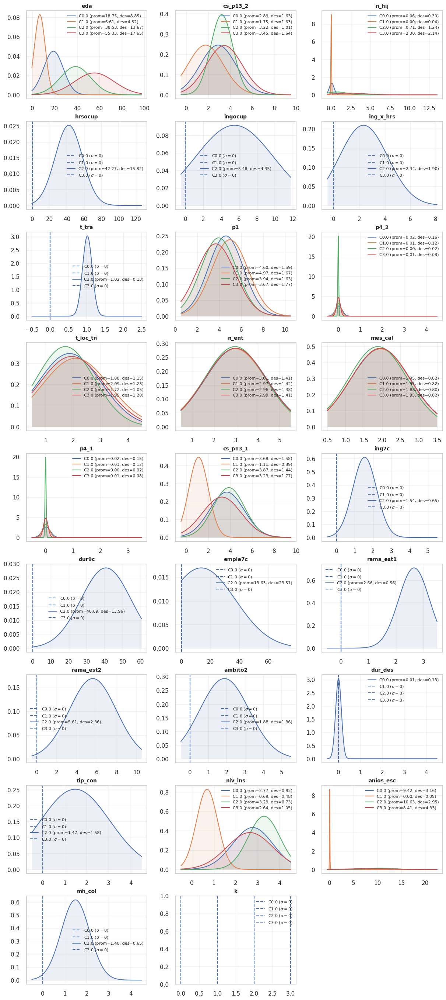

In [ ]:
import math
from scipy.stats import norm

n_cols = 3
n_rows = math.ceil(len(features) / n_cols)

fig, axes = plt.subplots(
    nrows=n_rows,
    ncols=n_cols,
    figsize=(12, 3 * n_rows),
    constrained_layout=True
)

axes_flat = axes.flatten()

for i, feature in enumerate(features):
    ax = axes_flat[i]

    global_min = agg_results[feature, 'min'].min()
    global_max = agg_results[feature, 'max'].max()

    x = np.linspace(global_min - 0.5, global_max + 0.5, 500)

    for cluster in clusters:
        mu = agg_results.loc[cluster, (feature, 'mean')]
        sigma = agg_results.loc[cluster, (feature, 'std')]

        if sigma > 0:
            pdf = norm.pdf(x, loc=mu, scale=sigma)
            label = f'C{cluster} (prom={mu:.2f}, des={sigma:.2f})'
            ax.plot(x, pdf, label=label)
            ax.fill_between(x, pdf, alpha=0.1)
        else:
            ax.axvline(
                mu,
                linestyle='--',
                label=f'C{cluster} ($\sigma=0$)'
            )

    ax.set_title(feature, fontsize=10, fontweight='bold')
    ax.legend(fontsize=8)
    ax.grid(True, alpha=0.3)

for j in range(i + 1, len(axes_flat)):
    fig.delaxes(axes_flat[j])

In [ ]:
display(agg_results)

eda                         cs_p13_2                         n_hij  \
          mean        std   min   max      mean       std  min  max      mean   
k                                                                               
0.0  18.753543   8.845029  12.0  97.0  2.886982  1.625295  0.0  9.0  0.055095   
1.0   6.612718   4.815879   0.0  93.0  1.748892  1.627141  0.0  9.0  0.000911   
2.0  38.527661  13.671378  12.0  93.0  3.222273  1.008464  0.0  9.0  0.714817   
3.0  55.327977  17.648865  12.0  97.0  3.450368  1.641396  0.0  9.0  2.298931   

                            hrsocup                       ingocup            \
          std  min   max       mean        std min  max      mean       std   
k                                                                             
0.0  0.304040  0.0   8.0   0.000000   0.000000   0    0  0.000000  0.000000   
1.0  0.043931  0.0   5.0   0.000000   0.000000   0    0  0.000000  0.000000   
2.0  1.237886  0.0  13.0  42.265132  15.819718   0  126  5.480361  4.349244   
3.0  2.140454  0.0  13.0   0.000000   0.000000   0    0  0.000000  0.000000   

                    ing_x_hrs                              t_tra            \
     min        max      mean       std  min       max      mean       std   
k                                                                            
0.0  0.0   0.000000  0.000000  0.000000  0.0  0.000000  0.000000  0.000000   
1.0  0.0   0.000000  0.000000  0.000000  0.0  0.000000  0.000000  0.000000   
2.0  0.0  11.256755  2.338998  1.904185  0.0  7.601402  1.017628  0.131596   
3.0  0.0   0.000000  0.000000  0.000000  0.0  0.000000  0.000000  0.000000   

                   p1                           p4_2                      \
    min max      mean       std  min   max      mean       std  min  max   
k                                                                          
0.0   0   0  4.596557  1.594248  1.0  10.0  0.022405  0.156153  0.0  4.0   
1.0   0   0  4.965802  1.673072  1.0  10.0  0.013963  0.122492  0.0  4.0   
2.0   1   2  3.942702  1.633496  1.0  10.0  0.000390  0.019742  0.0  1.0   
3.0   0   0  3.674760  1.769175  1.0  10.0  0.006928  0.084817  0.0  3.0   

    t_loc_tri                       n_ent                     mes_cal  \
         mean       std min max      mean       std min max      mean   
k                                                                       
0.0  1.875043  1.150210   1   4  3.006879  1.414115   1   5  1.954942   
1.0  2.094083  1.230758   1   4  2.966173  1.416625   1   5  1.945707   
2.0  1.719593  1.050703   1   4  2.963435  1.381390   1   5  1.882354   
3.0  1.949962  1.198132   1   4  2.993099  1.410028   1   5  1.951075   

                           p4_1                    cs_p13_1                 \
          std min max      mean       std min max      mean       std  min   
k                                                                            
0.0  0.822116   1   3  0.022223  0.153564   0   3  3.683136  1.577993  0.0   
1.0  0.822586   1   3  0.014056  0.123486   0   3  1.111784  0.892664  0.0   
2.0  0.799537   1   3  0.000390  0.019742   0   1  3.868778  1.435970  0.0   
3.0  0.816207   1   3  0.006862  0.083500   0   2  3.228975  1.772078  0.0   

             ing7c                        dur9c                        \
     max      mean       std min max       mean        std  min   max   
k                                                                       
0.0  9.0  0.000000  0.000000   0   0   0.000000   0.000000  0.0   0.0   
1.0  3.0  0.000000  0.000000   0   0   0.000000   0.000000  0.0   0.0   
2.0  9.0  1.540387  0.652852   0   5  40.687783  13.959952  0.0  60.0   
3.0  9.0  0.000000  0.000000   0   0   0.000000   0.000000  0.0   0.0   

       emple7c                       rama_est1                   rama_est2  \
          mean        std  min   max      mean       std min max      mean   
k                                                                            
0.0 

General
- En todas se tiene un promedio de que viven 4 personas mas menos 2 por vivienda
- El nivel escolar es casi igual en todos de promedio de secundaria llegando a la preparatoria/normal como desviacion salvo por el cluster 1

Cluster 0
- La mayoria de las personas tiene 18 años con una desviacion estandar de 8 años

Cluster 1
- Son el gupo mas joven con una edad de 6 años mas menos 4 años
- El nivel escolar mas bajo de preescolar a primaria sin terminar

Cluster 2
- Son un grupo de mas edad de 38 años mas menos 13 años
- Tiene una media de 42 horas trabajadas a la semana con una desviacion de 15 horas
- Son el unico que revibe dinero por trabajo y que tiene un trabajo
- tienden a tener la Secundaria completa llegando a la preparatoria
- el lugar de trabajo es de 13 personas en promedio con una desviacion de 23 personas

Cluster 3
- Son el grupo mas grande  de edad de 55 años mas menos 17 años.
- Son el grupos que mas hijos tiene de media 2 mas menos 2


###Outlier

In [ ]:
df_perfilamiento = df[cols_continuas+vivt_ordinales + hogt_ordinales + sdmet_ordinales+['ko']].dropna(subset=['ko']).copy()
agg_results = df_perfilamiento.groupby(df['ko']).agg(['mean','std','min','max'])
features = agg_results.columns.get_level_values(0).unique()
clusters = agg_results.index.unique()

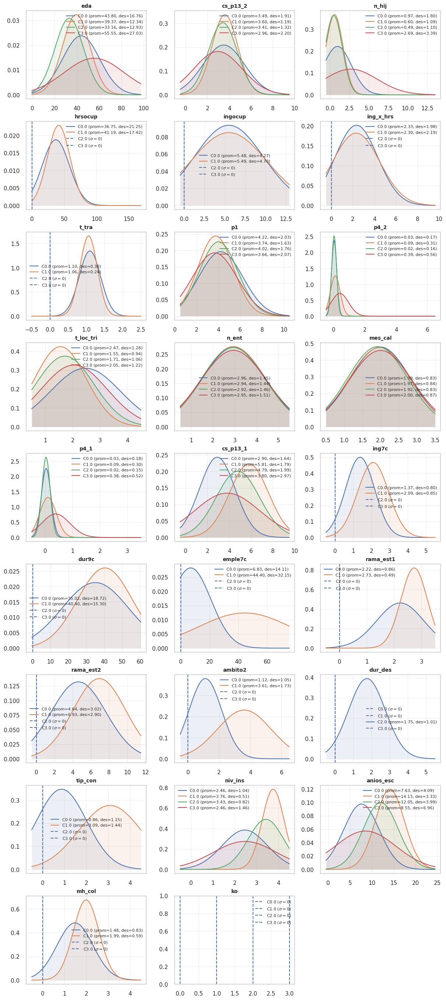

In [ ]:
import math
from scipy.stats import norm

n_cols = 3
n_rows = math.ceil(len(features) / n_cols)

fig, axes = plt.subplots(
    nrows=n_rows,
    ncols=n_cols,
    figsize=(12, 3 * n_rows),
    constrained_layout=True
)

axes_flat = axes.flatten()

for i, feature in enumerate(features):
    ax = axes_flat[i]

    global_min = agg_results[feature, 'min'].min()
    global_max = agg_results[feature, 'max'].max()

    x = np.linspace(global_min - 0.5, global_max + 0.5, 500)

    for cluster in clusters:
        mu = agg_results.loc[cluster, (feature, 'mean')]
        sigma = agg_results.loc[cluster, (feature, 'std')]

        if sigma > 0:
            pdf = norm.pdf(x, loc=mu, scale=sigma)
            label = f'C{cluster} (prom={mu:.2f}, des={sigma:.2f})'
            ax.plot(x, pdf, label=label)
            ax.fill_between(x, pdf, alpha=0.1)
        else:
            ax.axvline(
                mu,
                linestyle='--',
                label=f'C{cluster} ($\sigma=0$)'
            )

    ax.set_title(feature, fontsize=10, fontweight='bold')
    ax.legend(fontsize=8)
    ax.grid(True, alpha=0.3)

for j in range(i + 1, len(axes_flat)):
    fig.delaxes(axes_flat[j])

In [ ]:
display(agg_results)

eda                         cs_p13_2                         n_hij  \
          mean        std   min   max      mean       std  min  max      mean   
ko                                                                              
0.0  43.799596  16.764820  12.0  97.0  3.494124  1.912062  0.0  9.0  0.972675   
1.0  39.371114  12.336308  12.0  97.0  3.597329  1.186970  0.0  9.0  0.599068   
2.0  33.164130  12.933237  12.0  89.0  3.405702  1.318286  0.0  9.0  0.489116   
3.0  55.549738  27.030984   0.0  97.0  2.959876  2.197964  0.0  9.0  2.687272   

                            hrsocup                       ingocup            \
          std  min   max       mean        std min  max      mean       std   
ko                                                                            
0.0  1.802367  0.0  13.0  36.751607  21.254180   0  144  5.482709  4.269210   
1.0  1.087211  0.0  13.0  41.186939  17.416846   0  168  5.487740  4.699928   
2.0  1.098531  0.0  10.0   0.000000   0.000000   0    0  0.000000  0.000000   
3.0  3.394205  0.0  13.0   0.000000   0.000000   0    0  0.000000  0.000000   

                    ing_x_hrs                              t_tra            \
     min        max      mean       std  min       max      mean       std   
ko                                                                           
0.0  0.0  11.981259  2.328456  1.975795  0.0  8.160804  1.097157  0.296174   
1.0  0.0  12.429220  2.301415  2.190027  0.0  9.138127  1.061640  0.240502   
2.0  0.0   0.000000  0.000000  0.000000  0.0  0.000000  0.000000  0.000000   
3.0  0.0   0.000000  0.000000  0.000000  0.0  0.000000  0.000000  0.000000   

                   p1                           p4_2                      \
    min max      mean       std  min   max      mean       std  min  max   
ko                                                                         
0.0   1   2  4.219531  2.028945  1.0  10.0  0.025522  0.167800  0.0  6.0   
1.0   1   2  3.740596  1.630767  1.0  10.0  0.094642  0.314315  0.0  6.0   
2.0   0   0  4.020613  1.758590  1.0  10.0  0.022346  0.157905  0.0  3.0   
3.0   0   0  3.659383  2.066183  1.0  10.0  0.388765  0.555163  0.0  6.0   

    t_loc_tri                       n_ent                     mes_cal  \
         mean       std min max      mean       std min max      mean   
ko                                                                      
0.0  2.467656  1.284164   1   4  2.962995  1.451454   1   5  1.993821   
1.0  1.551266  0.938000   1   4  2.938531  1.439653   1   5  1.972744   
2.0  1.712772  1.064649   1   4  2.922751  1.455044   1   5  1.919091   
3.0  2.050532  1.217599   1   4  2.947640  1.511353   1   5  1.999603   

                           p4_1                    cs_p13_1                 \
          std min max      mean       std min max      mean       std  min   
ko                                                                           
0.0  0.832961   1   3  0.026647  0.176399   0   3  2.900379  1.641496  0.0   
1.0  0.838318   1   3  0.093105  0.304211   0   3  5.806694  1.788108  0.0   
2.0  0.828911   1   3  0.021961  0.151738   0   2  4.787324  1.987204  0.0   
3.0  0.871160   1   3  0.377324  0.516943   0   3  3.801208  2.971573  0.0   

             ing7c                        dur9c                        \
     max      mean       std min max       mean        std  min   max   
ko                                                                      
0.0  9.0  1.373393  0.798394   0   5  35.022414  18.720948  0.0  60.0   
1.0  9.0  2.091287  0.853522   0   5  40.398890  15.298454  0.0  60.0   
2.0  9.0  0.000000  0.000000   0   0   0.000000   0.000000  0.0   0.0   
3.0  9.0  0.000000  0.000000   0   0   0.000000   0.000000  0.0   0.0   

       emple7c                       rama_est1                   rama_est2  \
          mean        std  min   max      mean       std min max      mean   
ko                                                                           
0.0 

General
- Las edad son de gente de arriba de 30 y abarcan mas años en la desviaciones estandar
- En todas la cantidad de personas por vivienda ede casi 4 con mas menos 2 personas

Cluster 0
- Apenas estan alcanzando el primer hijo
- En promedio trbajan 36 horas pero tiene un desviacionde 21 horas
- Tiene un sueldo
- Tiene un solo trabajo
- El nivel mas bajo de educacion al rededor de la secundaria
- Gana entre un y 2 salarios minimos
- Trabaja alrededor de 35 horas pero tiene un poco mas de desviacion
- Su lugar de trabajo es en promedio 6 peronsas con una desviacion de 14 personas
- Tienen Micronegocios o no tienen establecimientos
- no tiene contrato especificado

Cluster 1
- Bajo nivel en hijos
- En promedio trbajan 41 horas pero tiene un desviacionde 17 horas
- Tiene un sueldo
- Tiene un solo trabajo
- El nivel mas alto de educacion de la carrera tecnica hacia arriba
- Gana entre dos y 3 salarios minimos
- Trabaja alrededor de 40 horas pero tiene un poco menos de desviacion
- Su lugar de trabajo es en promedio 44 peronsas con una desviacion de 32 personas
- Van de Pequeños establecimiento gasta grandes establecimentos
- Tiene contrato escrito
- El primero con mas años de escuela

Cluster 2
- Bajo nivel en hijos
- Son relaticamente los mas jovenes
- Son el unico con un valor en el tiempo de desempleo que va de 1 mes a 6 meses de desempleo
- El segundo con mas años de escuela

Cluster 3
- El grupo de mas edad
- Mayor cantidad de hijos como 2 mas menos 3
- Ligeramente tiende a contratar trabajdores domesticos

#Perfiles

##Limpios

Este grupo parece que clasifico a cada grupo en las diferentes etapas que una persona tiene en la vida.


Cluster 0: "Los Jovenes Estudiantes"

Jóvenes de 18 años (±8) que son hijos y nietos en sus hogares. Están solteros, asisten a la escuela y combinan sus estudios con quehaceres domésticos. Son Población No Económicamente Activa (PNEA), no disponibles para trabajar. Con educación promedio de secundaria avanzando a preparatoria, representan el capital humano en formación que prioriza la educación sobre el empleo.

Cluster 1: "Los Niños"

Perfil: El grupo más joven con 6 años (±4), compuesto por hijos y nietos. Están en preescolar o primaria sin terminar, y la mitad aún no sabe leer ni escribir, asisten activamente a la escuela. Las clasificaciones laborales "no aplican" para este grupo infantil que está en pleno proceso de formación educativa inicial.

Cluster 2: "Los Trabajadores Activos"

Perfil: La fuerza laboral principal con 38 años (±13). Incluyen hijos, nietos, jefes de hogar y parejas en diversos estados civiles. Son Población Económicamente Activa y Ocupada, trabajando 42 horas semanales (±15) como subordinados y remunerados. Son el único cluster limpio que recibe ingresos por trabajo consistentemente. La mitad trabaja formal y la otra mitad informal. Operan en empresas de 13 empleados en promedio, con educación de secundaria completa llegando a preparatoria. Dos tercios carecen de servicios de salud por su trabajo, y participan en actividades económicas muy variadas.

Cluster 3: "Cuidadores del Hogar"

Perfil: El grupo de mayor edad con 55 años (±17), compuesto por parejas/cónyuges y jefes de hogar, predominantemente casados y con sesgo femenino. Son PNEA no disponibles, dedicados principalmente a quehaceres domésticos, aunque algunos son pensionados/jubilados. Tienen el mayor promedio de hijos (2±2) y 20% nació en otro estado. Representan el trabajo doméstico no remunerado que sostiene los hogares, aunque ya no participen del mercado laboral formal.

##Outliers

En este subconjunto se presentaran los diferentes estados que tiene una persona en el mundo laboral.

Cluster 0: "Los Trabajadores del Sector Informal"

Perfil: Jefes de hogar mayores de 30 años en unión libre o casados, con carreras no especificadas. Trabajan en construcción y agropecuario con patrones altamente irregulares: 36 horas semanales (±21). Máxima desprotección social: 86% sin servicios de salud, solo 14% con IMSS. Diversidad laboral: 50% subordinados, 25% cuenta propia, 10% empleadores, resto sin pago. Operan en micronegocios (6 personas promedio) o sin establecimiento, sin contratos, en agricultura de subsistencia y sector informal. Educación básica incompleta, ganan 1-2 salarios mínimos. Representan la informalidad rural y de construcción con estrategias económicas flexibles pero precarias.

Cluster 1: "Los Profesionales con Empleo Formal"

Perfil: Jefes de hogar mayores de 30 años, mayormente casados, con formación en ingenierías, administración, derecho, educación y medicina. El cluster con mejores condiciones laborales: la mayoria tiene acceso a salud, contratos escritos, empleos en corporaciones/gobierno/empresas formales. Trabajan 41 horas semanales (±17) en establecimientos de 44 empleados promedio, como profesionales, técnicos, funcionarios y directivos. tienen un buen nivel de escolaridad (carrera técnica en adelante), ganan 2-3 salarios mínimos. Satisfechos laboralmente, no buscan cambio. Representan la clase media profesional estable del sistema formal mexicano.

Cluster 2: "Los Jóvenes Desempleados"

Perfil: Los más jóvenes de los outliers, principalmente hijos solteros con carreras en TIC, ingenierías y arquitectura. Población Económicamente Activa pero Desocupada y buscando empleo activamente. Segundo grupo con más escolaridad pero con desempleo de 1-6 meses. Mientras buscan trabajo, realizan quehaceres domésticos. Sin acceso a servicios de salud, rechazán empleos no relacionados con su formación. Jóvenes profesionales en áreas supuestamente demandadas que no logran insertarse laboralmente.

Cluster 3: "Los Profesionales Retirados y No Activos Económicamente"

Perfil: El grupo de mayor edad, jefes de hogar con familias extensas multigeneracionales. Formación en docencia, medicina, enfermería y servicios. Población No Económicamente Activa dedicados a quehaceres domésticos o son pensionados/jubilados. Muchos viudos, con más hijos promedio 2±3. La mitad migró de otro estado. Ocasionalmente contratan trabajadores domésticos. PArece que representan trayectorias profesionales formales completadas, ahora en retiro con roles familiares como abuelos y pilares del hogar.